# Template of  jupyter notebook for analysis of WAXS

# Load package

In [1]:
%matplotlib notebook
from pyScatt.packages import *
plt.rcParams.update({'figure.max_open_warning': 0})
plt.rcParams.update({ 'image.origin': 'lower'   })
plt.rcParams.update({ 'image.interpolation': 'none'   })

In [2]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/generic_functions.py

## Define path

In [3]:
scat = 'WAXS'
det =  'Pilatus300kw' 
det = '300KW' 

proposal = '308052_Zhang' 
cycle = '2020_Cycle3'
beamline = 'SMI'

username = 'Yugang' 

#inDir =  '/home/group/NSLSII_Data/SMI/2020_Cycle1/AB_CUNNY/AB2_1/'
inDir ='/home/yuzhang/NSLSII_Data_Link/SMI/%s/%s/raw_data/%s/'%(cycle, proposal, det )
print('The input dir is: %s'%inDir)


outDir0_ = '/home/yuzhang/NSLSII_Data_Link/SMI/%s/%s/Results/'%(cycle, proposal  )
outDir0_ = create_fullpath(  outDir0_ )
outDir0 = create_fullpath(  outDir0_ + username + '/' )
print('The output dir is: %s'%outDir0)
 

The input dir is: /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/raw_data/300KW/
Directory  /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/  already exists
Directory  /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/  already exists
The output dir is: /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/


In [4]:
flag_save = True 

outDir1 = create_fullpath(  outDir0   + '%s/'%(scat)) 
#outDir = create_dir(  'Results/', outDir1 )
outDir = create_fullpath(  outDir0   + 'Stitched/' ) 
outDir2 = create_fullpath(  outDir0   + 'Stitched/pngs/' ) 
#create_dir( '%s/Results/TIFF/'%(scat), outDir0  )
outDir_HDF =  create_dir(  'HDF_Results/', outDir0 )
#outDir_ResPipe = create_dir(  'ResPipes/', outDir1 )

print( outDir )
print( outDir_HDF)
#print( outDir_ResPipe)

Directory  /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/WAXS/  already exists
Directory  /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/Stitched/  already exists
Directory  /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/Stitched/pngs/  already exists
Directory  /home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/HDF_Results/  already exists
/home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/Stitched/
/home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Results/Yugang/HDF_Results/


# Find data

In [5]:
username_ = 'FL'

flists = ls_dir( inDir, and_list=[  username_, 'CB4', '_z'  ], no_list=[ ])
flists = ls_dir( inDir, and_list=[  username_, 'OC4', '_z'  ], no_list=[ ])

Nf = len( flists)
print('There are %s files for user: %s in this run.'%(Nf, username))

There are 330 files for user: Yugang in this run.


In [6]:
flists

array(['_FL_OC4_x991.93_y-4899.85_z900.0_waxsP13.00_expt1s_attNone_sid00136057_000001_WAXS.tif',
       '_FL_OC4_x991.97_y-4899.9_z5400.0_waxsP19.50_expt1s_attNone_sid00136094_000001_WAXS.tif',
       '_FL_OC4_x991.96_y-4899.83_z-2600.0_waxsP39.00_expt1s_attNone_sid00136174_000001_WAXS.tif',
       '_FL_OC4_x991.97_y-4799.9_z1650.0_waxsP39.00_expt1s_attNone_sid00136510_000001_WAXS.tif',
       '_FL_OC4_x991.98_y-4799.88_z900.0_waxsP45.50_expt1s_attNone_sid00136537_000001_WAXS.tif',
       '_FL_OC4_x991.92_y-4899.78_z-2600.0_waxsP32.50_expt1s_attNone_sid00136144_000001_WAXS.tif',
       '_FL_OC4_x991.97_y-4899.88_z1899.99_waxsP52.00_expt1s_attNone_sid00136241_000001_WAXS.tif',
       '_FL_OC4_x991.9_y-4799.84_z-14600.0_waxsP19.50_expt1s_attNone_sid00136412_000001_WAXS.tif',
       '_FL_OC4_x991.95_y-4799.88_z900.0_waxsP26.00_expt1s_attNone_sid00136447_000001_WAXS.tif',
       '_FL_OC4_x991.95_y-4799.81_z-6600.0_waxsP39.00_expt1s_attNone_sid00136503_000001_WAXS.tif',
       '_FL_OC4_x991

## Sort data

* A litt mess for this dataset, todolist: make a better filename pattern

In [7]:
pz_list =  np.array( [ -14600,  -6600, -2600,  -600, 400, 900, 1150, 1400,
                      1650, 1900, 2400, 3400,  5400,  9400, 17400  ] )
angles =  np.linspace(0, 65, 11)
Nz, Na = len(pz_list), len(angles)
print(  Nz, Na )

15 11


In [8]:
15 * 11 *2

330

In [9]:
cut_beg = -24
cut_end=-16
sflistd = sort_fnlist( flists, pattern='', cut_beg = cut_beg, cut_end=cut_end, method='cut_from_end' )

D1 = {}
D2 = {}
start_sid =  135992  #135977
start_sid2 = 136322 #136307
for i in range( Nz ):
    
    D1[i] = [ sflistd['%08d'%j] for j in  (start_sid + np.arange( 0, 30*Na , 30 ))  ]
    D2[i] = [ sflistd['%08d'%j] for j in  (start_sid2 + np.arange( 0, 30*Na , 30 ))  ]
    
    print( start_sid, start_sid2, len(D1[i]) )
    #print( D1[i])
    print( )
    start_sid += 1
    start_sid2 += 1
    
    


135992 136322 11

135993 136323 11

135994 136324 11

135995 136325 11

135996 136326 11

135997 136327 11

135998 136328 11

135999 136329 11

136000 136330 11

136001 136331 11

136002 136332 11

136003 136333 11

136004 136334 11

136005 136335 11

136006 136336 11



In [10]:
sflistd

{'00135992': '_FL_OC4_x991.92_y-4899.79_z-14600.0_waxsP00.00_expt1s_attNone_sid00135992_000001_WAXS.tif',
 '00135993': '_FL_OC4_x991.92_y-4899.85_z-6600.0_waxsP00.00_expt1s_attNone_sid00135993_000001_WAXS.tif',
 '00135994': '_FL_OC4_x991.93_y-4899.85_z-2600.0_waxsP00.00_expt1s_attNone_sid00135994_000001_WAXS.tif',
 '00135995': '_FL_OC4_x991.93_y-4899.92_z-600.01_waxsP00.00_expt1s_attNone_sid00135995_000001_WAXS.tif',
 '00135996': '_FL_OC4_x991.93_y-4899.87_z400.0_waxsP00.00_expt1s_attNone_sid00135996_000001_WAXS.tif',
 '00135997': '_FL_OC4_x991.93_y-4899.88_z900.0_waxsP00.00_expt1s_attNone_sid00135997_000001_WAXS.tif',
 '00135998': '_FL_OC4_x991.93_y-4899.89_z1150.0_waxsP00.00_expt1s_attNone_sid00135998_000001_WAXS.tif',
 '00135999': '_FL_OC4_x991.94_y-4899.89_z1400.0_waxsP00.00_expt1s_attNone_sid00135999_000001_WAXS.tif',
 '00136000': '_FL_OC4_x991.93_y-4899.87_z1650.0_waxsP00.00_expt1s_attNone_sid00136000_000001_WAXS.tif',
 '00136001': '_FL_OC4_x991.93_y-4899.89_z1900.0_waxsP00.00_ex

# Load mask

In [11]:
#mask  =np.load( '/home/yuzhang/NSLSII_Data_Link/SMI/2020_Cycle3/308052_Zhang/Mask/mask_waxs_2020C3_YG.npy')
#show_img(mask)
mask = None

## Define parameters

In [12]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering.py

In [106]:
273.9+1.4

275.29999999999995

In [108]:
geometry   =  'Reflection'
wav_m = 1E-10 * (12.398/16.1)
sdd_mm = 273.9 + 1.4    
b_xy = [98, 1388]  
bs_xy = [98, 1250]  #for SMI beamline
incident_angle = 0
det_str = 'Pilatus300kw' #for SMI beamline


  
pargs_sc = dict( wav_m = wav_m, 
                sdd_mm = sdd_mm, 
                b_xy =b_xy, 
                bs_xy = bs_xy, 
                incident_angle = incident_angle,             
                det_str = det_str, 
                bs_kind = None, 
                useqx = True,
                geometry =  geometry,                
                username = username, # 'Fang', 
                cycle =  cycle, # ='2020_Cycle2',
                beamline = beamline, #'SMI',
                outDir = outDir, )
              # mask = mask )
    

rot_angle_start = 0
rot_angle_step = 6.5 

#N =  11
#rot_angle = -np.arange( rot_angle_start,  rot_angle_step * N,  rot_angle_step )
#print(rot_angle)
## Setup the class
SC = SMI_Scattering( pargs_sc  )
#SC.set_rotation_angles( rot_angle  ) 


In [109]:
#%matplotlib inline


In [110]:
%matplotlib notebook

# Do data reduction

In [177]:
T = True
F = False

In [178]:
%run -i /home/yuzhang/Software/pyScatt/pyScatt/generic_functions.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering.py
%run -i /home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py

In [179]:
do_plot = T #True 
do_plot_raw = T # True
#do_inpait = True, make it True, the circular average does not use inpaited data 

do_show_plot = T
save_raw = F


if T:    
    ###########################
    #for stitch
    ###########################
    do_qimg = F
    check_stitch = T
    do_stitch = T
    do_ciravg = T 
    show_Au_Diff = T    
    

In [264]:
ssam_dict = D2
ks =  list( ssam_dict.keys() )


In [265]:
"""#ssam_dict = D1
ssam_dict = D2
ks =  list( ssam_dict.keys() )
ki =  2 # 14 #0 #7

sample_list = ks[ ki:ki+1]
 
pz = pz_list[ki]
#sdd_dz = 1400 - pz
sdd_dz = -pz
print( sdd_mm + sdd_dz/1000  )
print( pz, sdd_dz/1000, sample_list, ssam_dict[sample_list[0]][0] )
#print(  - round( (-pz - 1400.0)/172.0,2 ) )
print(   -round( (pz - 4200.0)/172.0,2 ) )
print(   -round( (pz - 4300.0)/172.0,2 ) )

110 * .172, 77.5 * .172

14.6 - 18.9, 17.4 - 13.2

(9.4-4.2)/.172, ( 2.4 - 4.2)/.172, (5.4-4.2)/.172,

pz

pz_list

SC.sdd_mm   

{ -14600: [ 110, 289.9 ], 
 

 1400: [16 , 273.9 ],
 
 
 
1900: [ 13.5, 272.9  ],  
2400: [ 10, 272.9  ],
3400: [  4.7, 269.9 ], 
5400: [  -7, 269.9 ],  
 9400: [ -31, 265.9 ], 
 17400: [ -77.5,  257.9  ],



}

ks

sam

"""

'#ssam_dict = D1\nssam_dict = D2\nks =  list( ssam_dict.keys() )\nki =  2 # 14 #0 #7\n\nsample_list = ks[ ki:ki+1]\n \npz = pz_list[ki]\n#sdd_dz = 1400 - pz\nsdd_dz = -pz\nprint( sdd_mm + sdd_dz/1000  )\nprint( pz, sdd_dz/1000, sample_list, ssam_dict[sample_list[0]][0] )\n#print(  - round( (-pz - 1400.0)/172.0,2 ) )\nprint(   -round( (pz - 4200.0)/172.0,2 ) )\nprint(   -round( (pz - 4300.0)/172.0,2 ) )\n\n110 * .172, 77.5 * .172\n\n14.6 - 18.9, 17.4 - 13.2\n\n(9.4-4.2)/.172, ( 2.4 - 4.2)/.172, (5.4-4.2)/.172,\n\npz\n\npz_list\n\nSC.sdd_mm   \n\n{ -14600: [ 110, 289.9 ], \n \n\n 1400: [16 , 273.9 ],\n \n \n \n1900: [ 13.5, 272.9  ],  \n2400: [ 10, 272.9  ],\n3400: [  4.7, 269.9 ], \n5400: [  -7, 269.9 ],  \n 9400: [ -31, 265.9 ], \n 17400: [ -77.5,  257.9  ],\n\n\n\n}\n\nks\n\nsam\n\n'

# For stitching

The sample is: 0.
['_FL_OC4_x991.95_y-4799.84_z-14599.99_waxsP00.00_expt1s_attNone_sid00136322_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.84_z-14599.99_waxsP06.50_expt1s_attNone_sid00136352_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.84_z-14600.0_waxsP13.00_expt1s_attNone_sid00136382_000001_WAXS.tif', '_FL_OC4_x991.9_y-4799.84_z-14600.0_waxsP19.50_expt1s_attNone_sid00136412_000001_WAXS.tif', '_FL_OC4_x991.91_y-4799.83_z-14600.0_waxsP26.00_expt1s_attNone_sid00136442_000001_WAXS.tif', '_FL_OC4_x991.92_y-4799.81_z-14600.0_waxsP32.50_expt1s_attNone_sid00136472_000001_WAXS.tif', '_FL_OC4_x991.92_y-4799.83_z-14600.0_waxsP39.00_expt1s_attNone_sid00136502_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.79_z-14600.0_waxsP45.50_expt1s_attNone_sid00136532_000001_WAXS.tif', '_FL_OC4_x991.9_y-4800.06_z-14600.0_waxsP52.00_expt1s_attNone_sid00136562_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.85_z-14600.0_waxsP58.50_expt1s_attNone_sid00136592_000001_WAXS.tif', '_FL_OC4_x991.91_y-4799.85_z-14600.0_waxsP65.00_exp

<IPython.core.display.Javascript object>


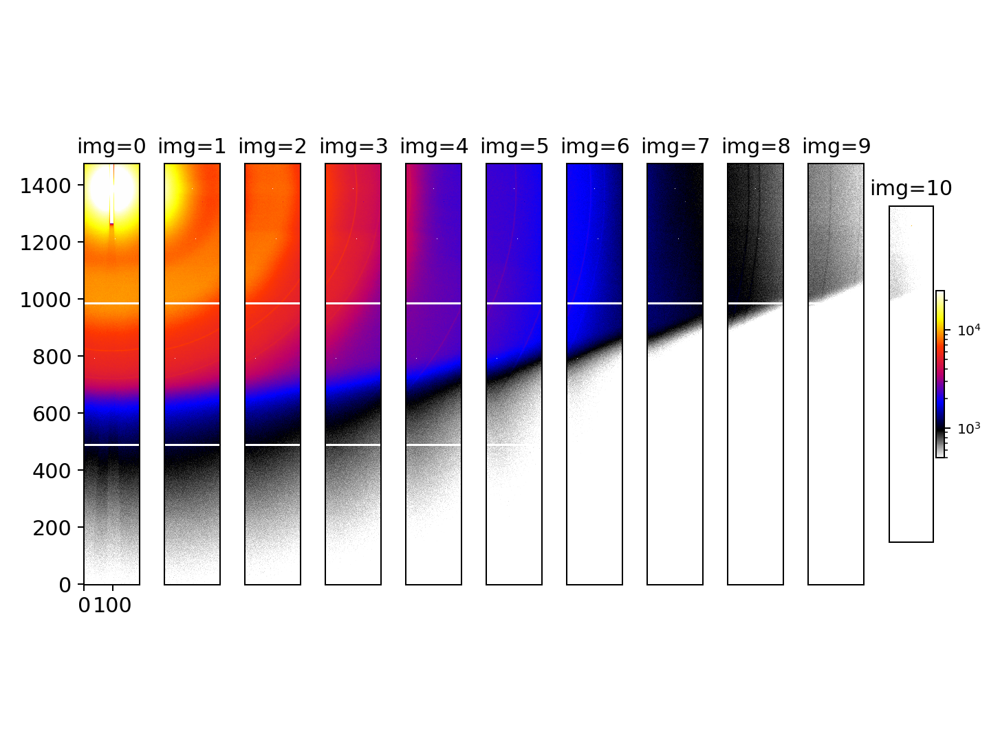

<IPython.core.display.Javascript object>


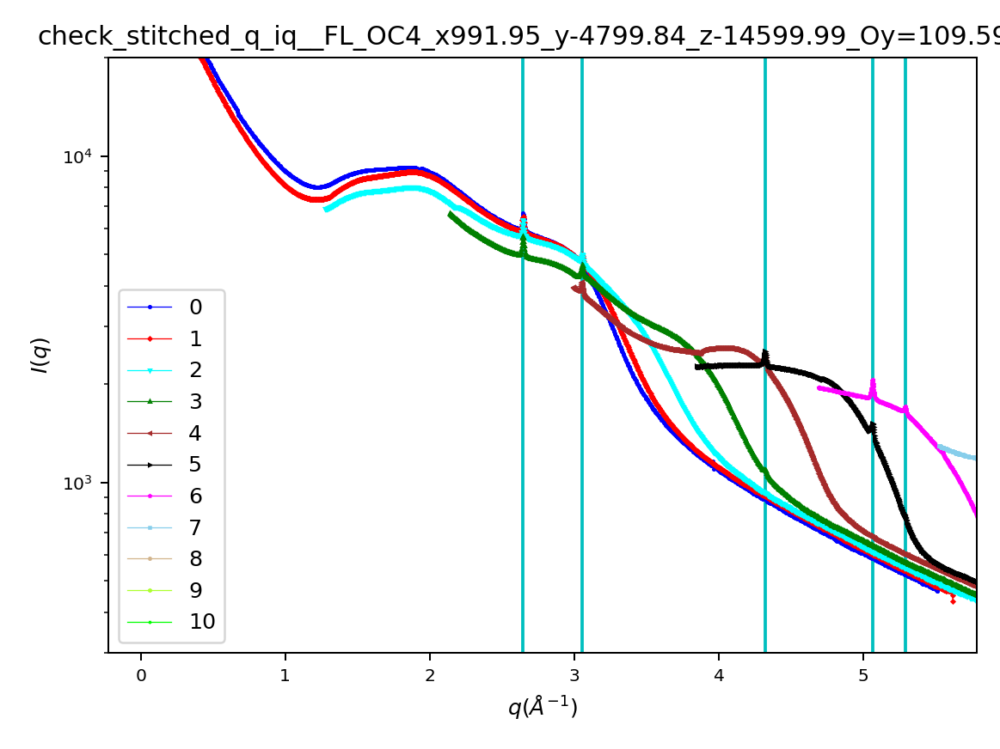

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


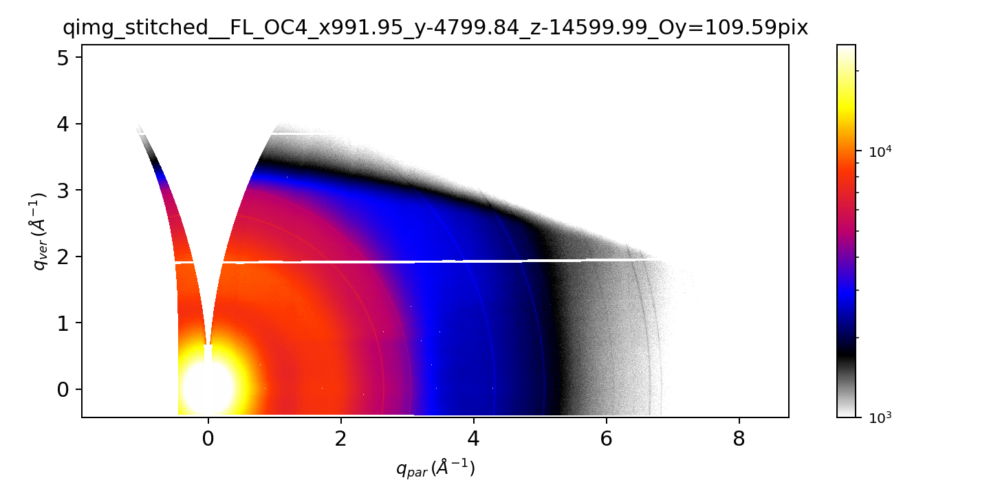

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


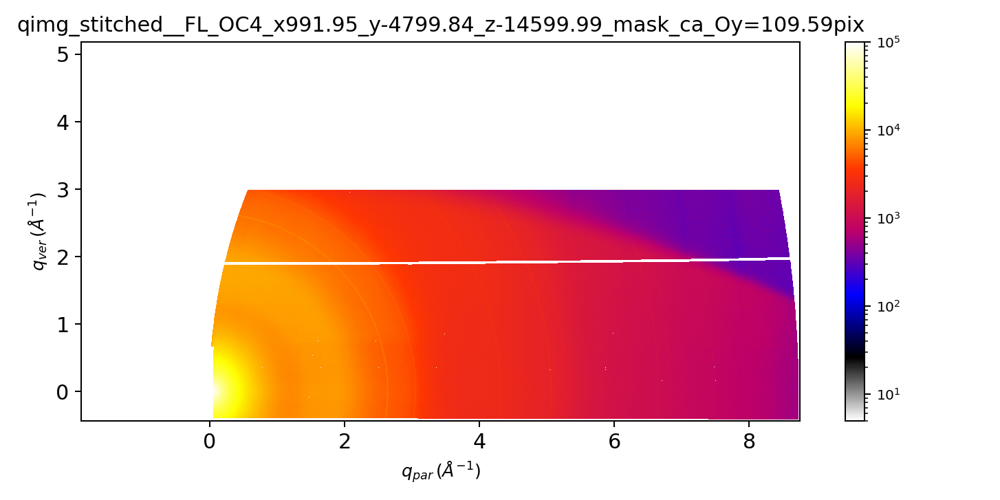

<IPython.core.display.Javascript object>


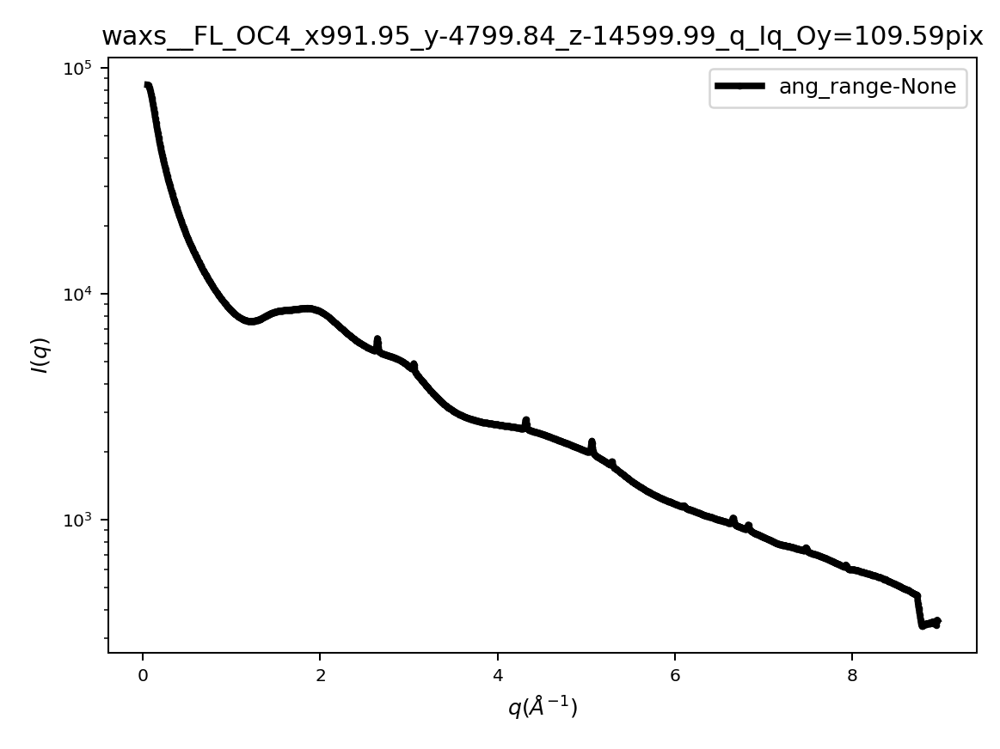

2.6685292985643927


<IPython.core.display.Javascript object>


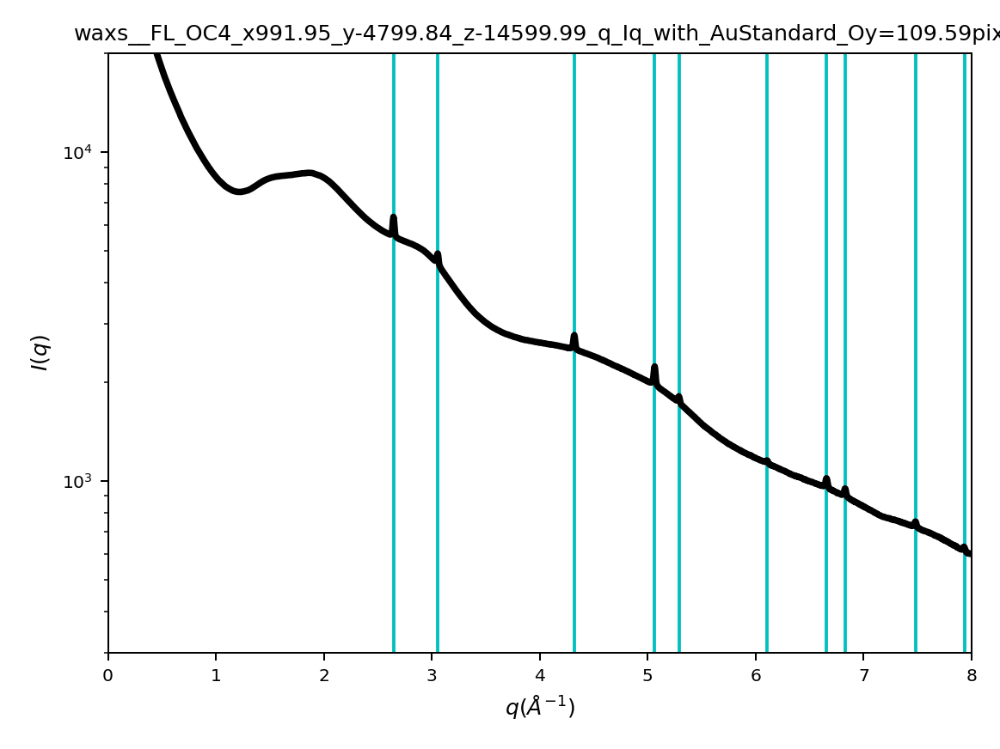

The sample is: 1.
['_FL_OC4_x991.94_y-4799.84_z-6600.0_waxsP00.00_expt1s_attNone_sid00136323_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.82_z-6600.0_waxsP06.50_expt1s_attNone_sid00136353_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.9_z-6600.0_waxsP13.00_expt1s_attNone_sid00136383_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.82_z-6600.0_waxsP19.50_expt1s_attNone_sid00136413_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.83_z-6600.0_waxsP26.00_expt1s_attNone_sid00136443_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.83_z-6600.0_waxsP32.50_expt1s_attNone_sid00136473_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.81_z-6600.0_waxsP39.00_expt1s_attNone_sid00136503_000001_WAXS.tif', '_FL_OC4_x991.91_y-4799.8_z-6600.0_waxsP45.50_expt1s_attNone_sid00136533_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.88_z-6600.0_waxsP52.00_expt1s_attNone_sid00136563_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.83_z-6600.0_waxsP58.50_expt1s_attNone_sid00136593_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.82_z-6600.0_waxsP65.00_expt1s_attNone_s

<IPython.core.display.Javascript object>


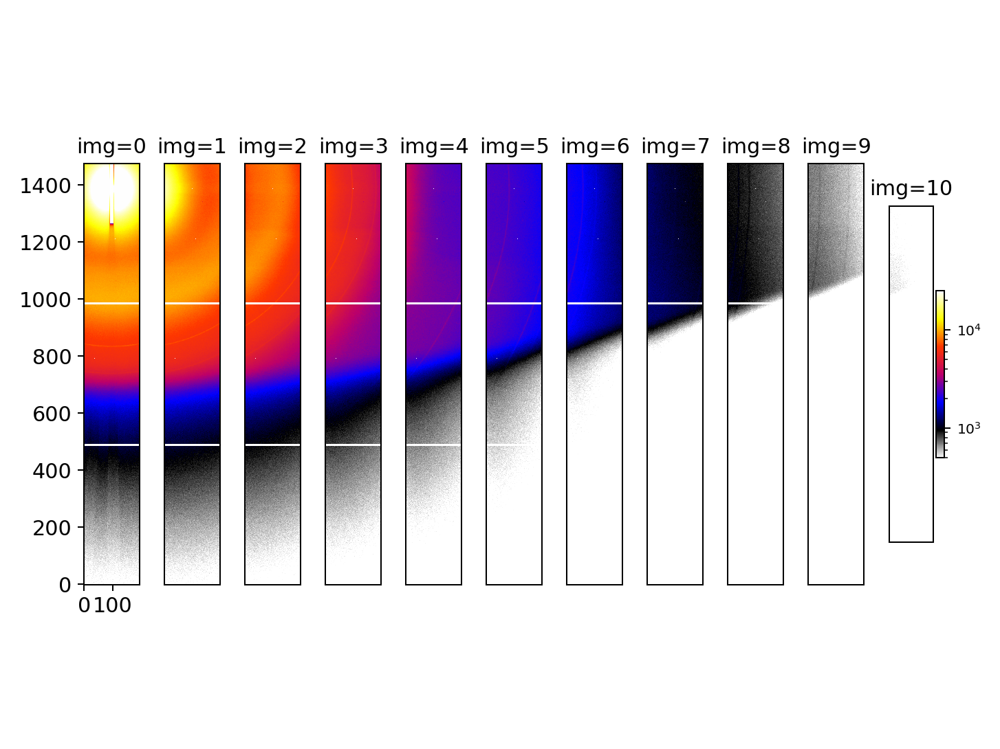

<IPython.core.display.Javascript object>


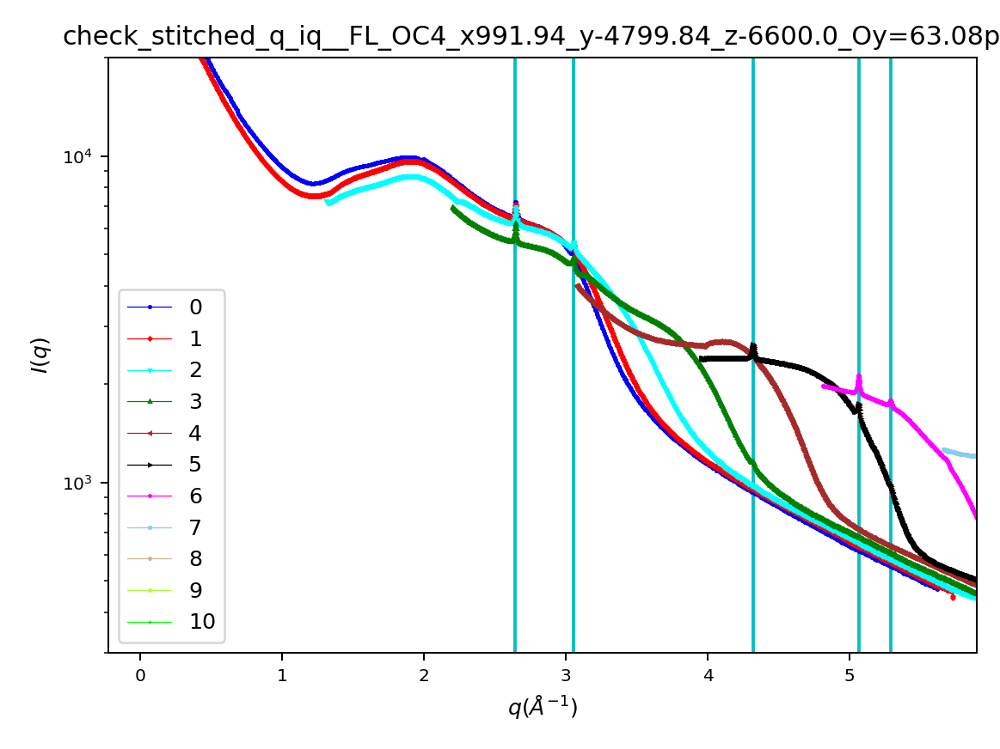

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


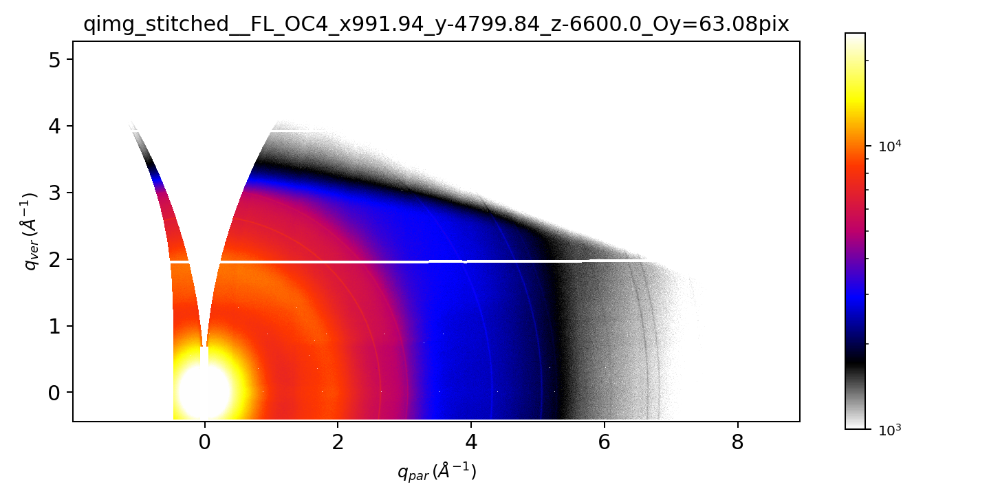

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


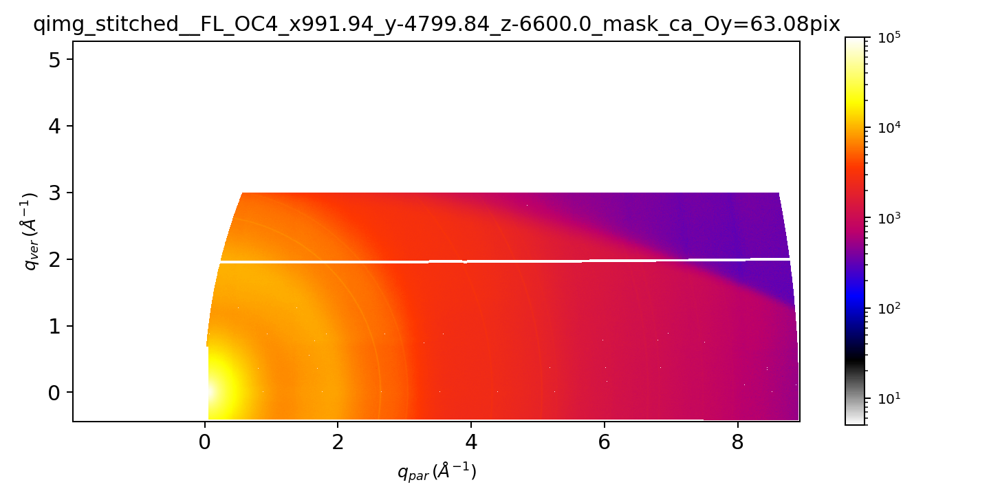

<IPython.core.display.Javascript object>


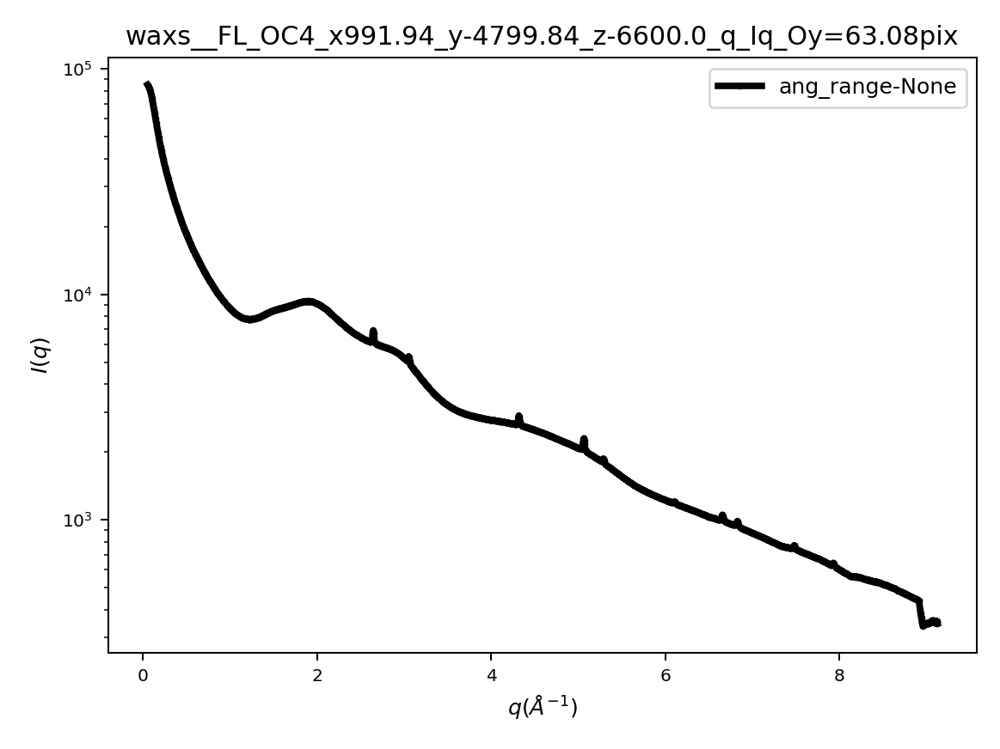

2.6685292985643927


<IPython.core.display.Javascript object>


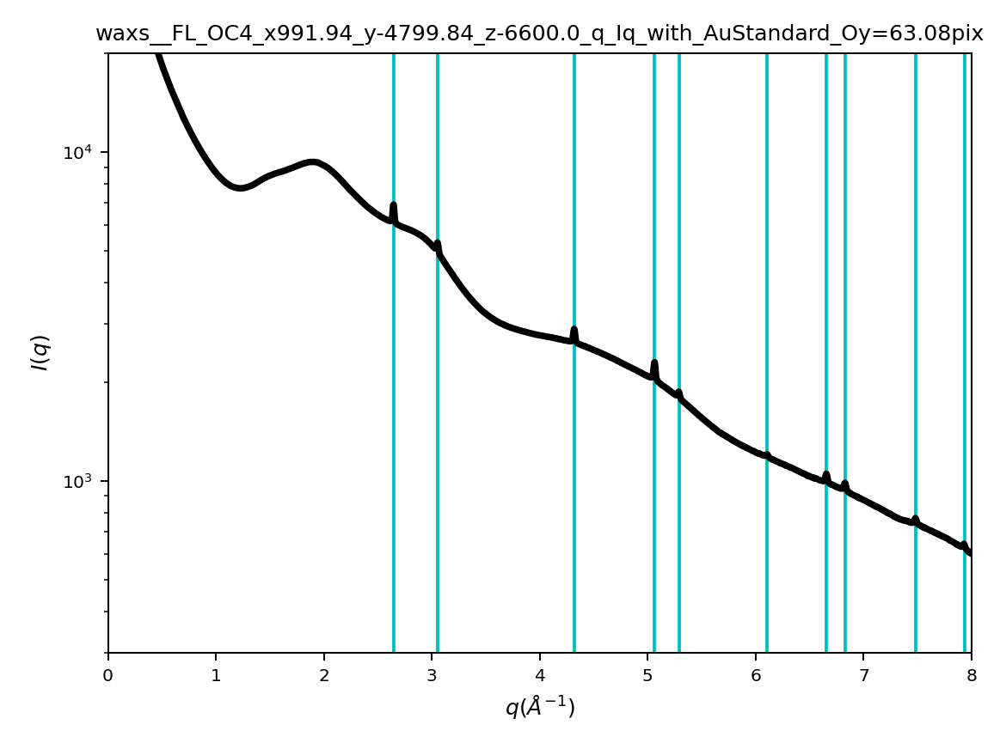

The sample is: 2.
['_FL_OC4_x991.96_y-4799.8_z-2600.0_waxsP00.00_expt1s_attNone_sid00136324_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.78_z-2600.0_waxsP06.50_expt1s_attNone_sid00136354_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.92_z-2600.0_waxsP13.00_expt1s_attNone_sid00136384_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.84_z-2600.0_waxsP19.50_expt1s_attNone_sid00136414_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.83_z-2600.0_waxsP26.00_expt1s_attNone_sid00136444_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.84_z-2600.0_waxsP32.50_expt1s_attNone_sid00136474_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.83_z-2600.0_waxsP39.00_expt1s_attNone_sid00136504_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.84_z-2600.0_waxsP45.50_expt1s_attNone_sid00136534_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.86_z-2600.0_waxsP52.00_expt1s_attNone_sid00136564_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.78_z-2600.0_waxsP58.50_expt1s_attNone_sid00136594_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.91_z-2600.0_waxsP65.00_expt1s_attNone_

<IPython.core.display.Javascript object>


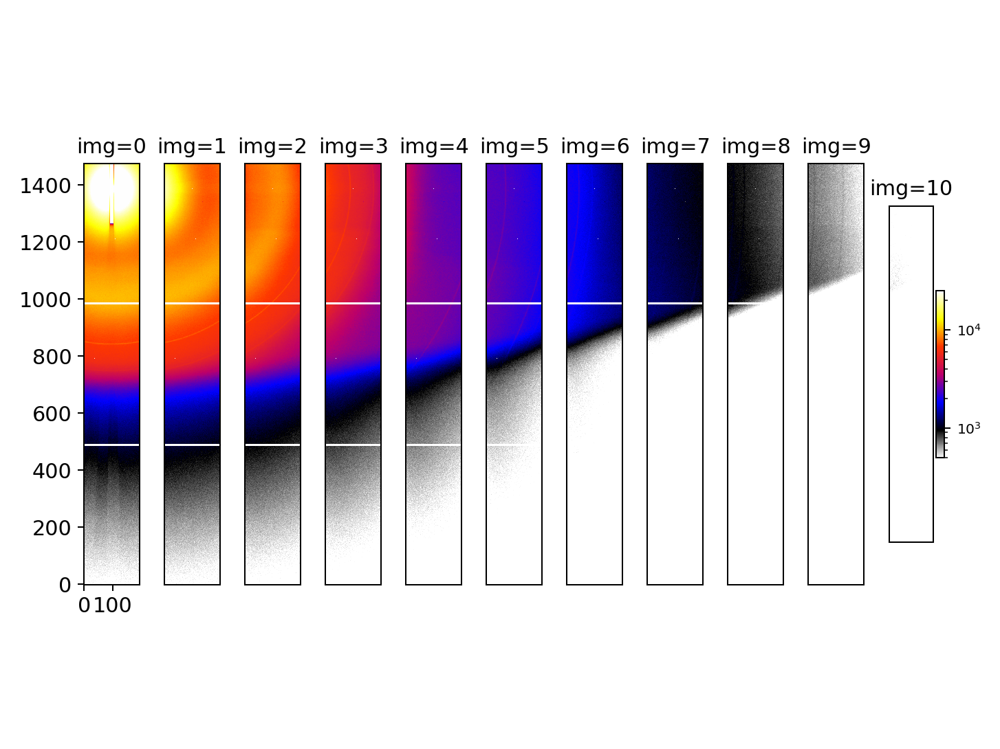

<IPython.core.display.Javascript object>


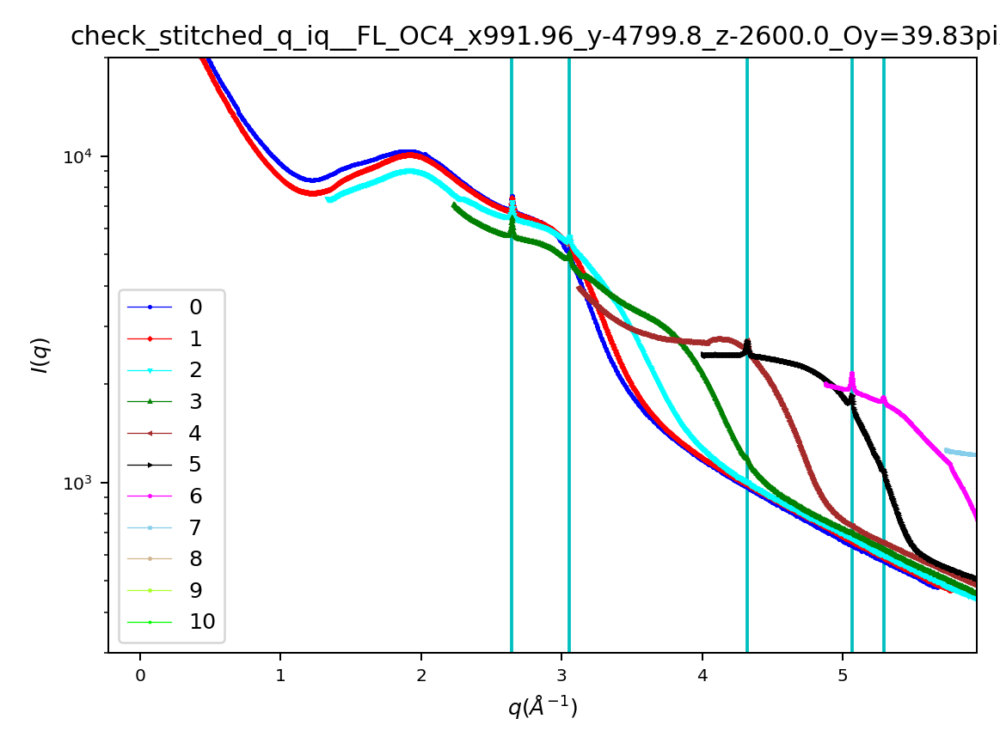

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


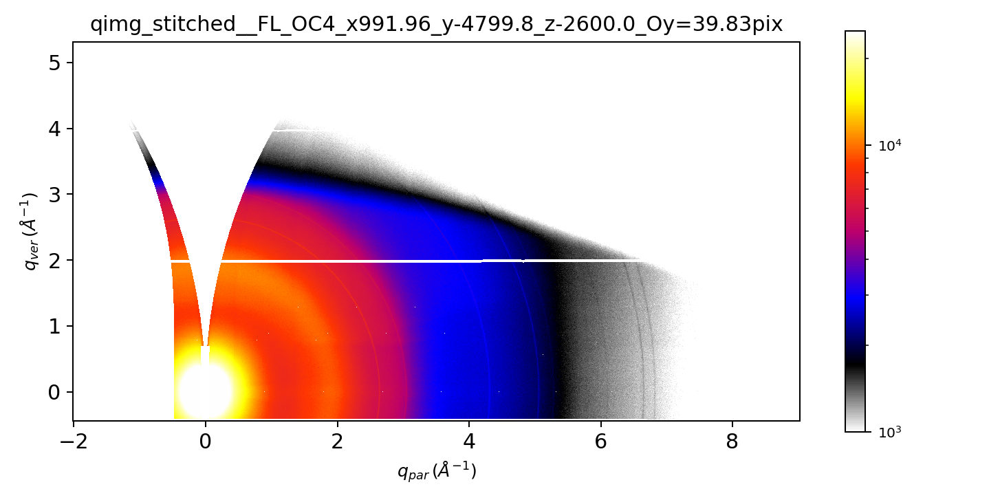

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


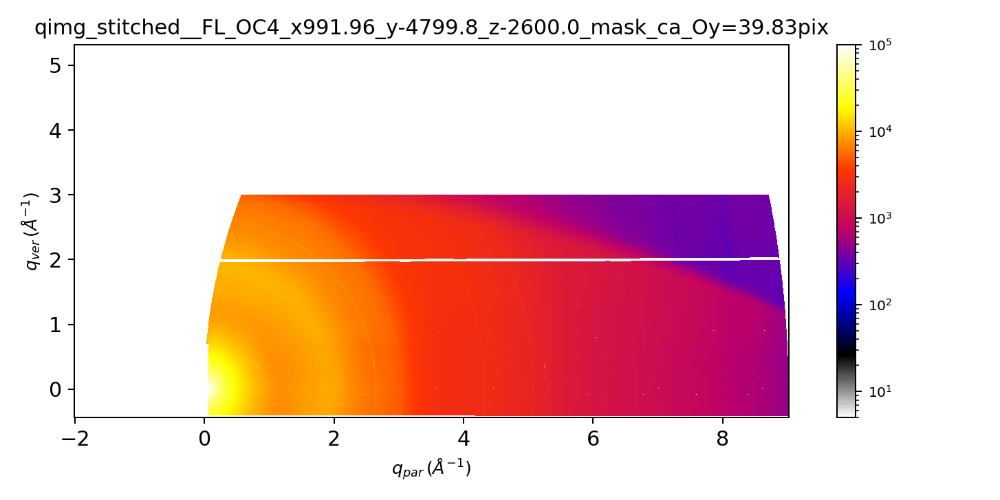

<IPython.core.display.Javascript object>


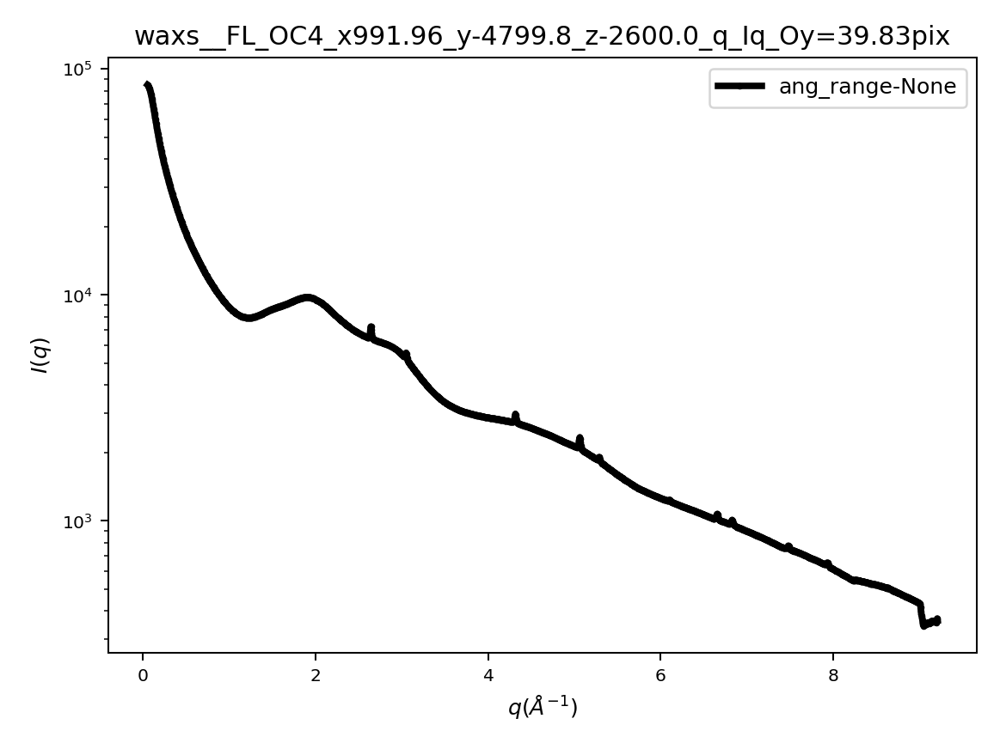

2.6685292985643927


<IPython.core.display.Javascript object>


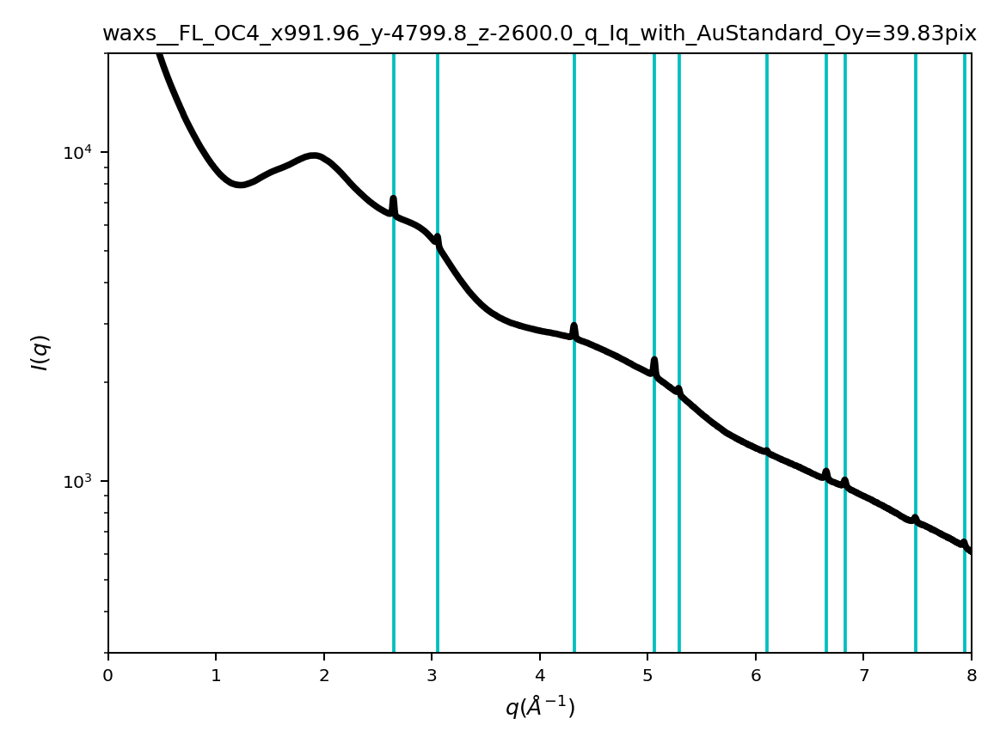

The sample is: 3.
['_FL_OC4_x991.96_y-4799.87_z-600.0_waxsP00.00_expt1s_attNone_sid00136325_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.96_z-600.01_waxsP06.50_expt1s_attNone_sid00136355_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.88_z-600.0_waxsP13.00_expt1s_attNone_sid00136385_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.84_z-600.0_waxsP19.50_expt1s_attNone_sid00136415_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.53_z-600.0_waxsP26.00_expt1s_attNone_sid00136445_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.84_z-600.0_waxsP32.50_expt1s_attNone_sid00136475_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.84_z-599.99_waxsP39.00_expt1s_attNone_sid00136505_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.84_z-600.0_waxsP45.50_expt1s_attNone_sid00136535_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.87_z-600.0_waxsP52.00_expt1s_attNone_sid00136565_000001_WAXS.tif', '_FL_OC4_x992.03_y-4799.86_z-600.0_waxsP58.50_expt1s_attNone_sid00136595_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.93_z-600.0_waxsP65.00_expt1s_attNone_sid00136

<IPython.core.display.Javascript object>


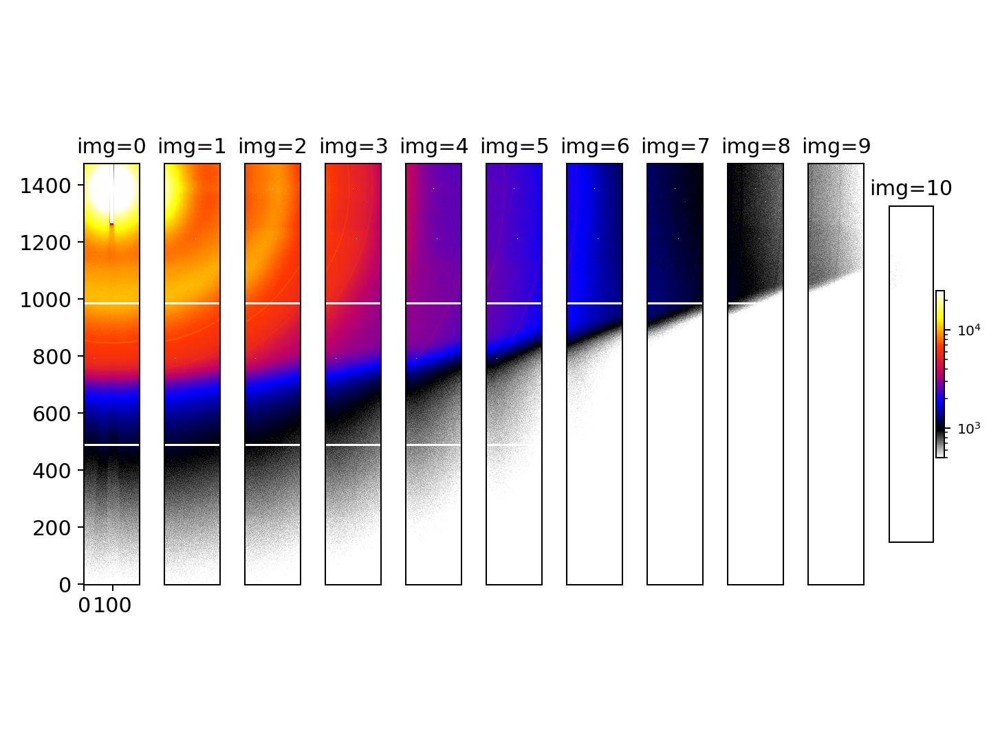

<IPython.core.display.Javascript object>


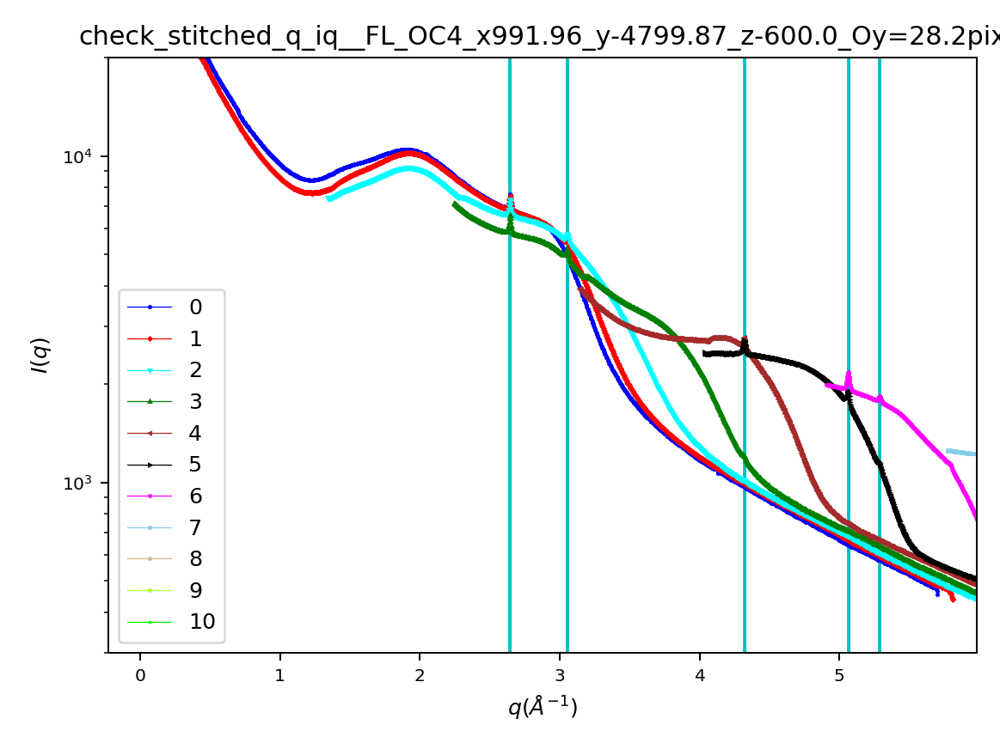

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


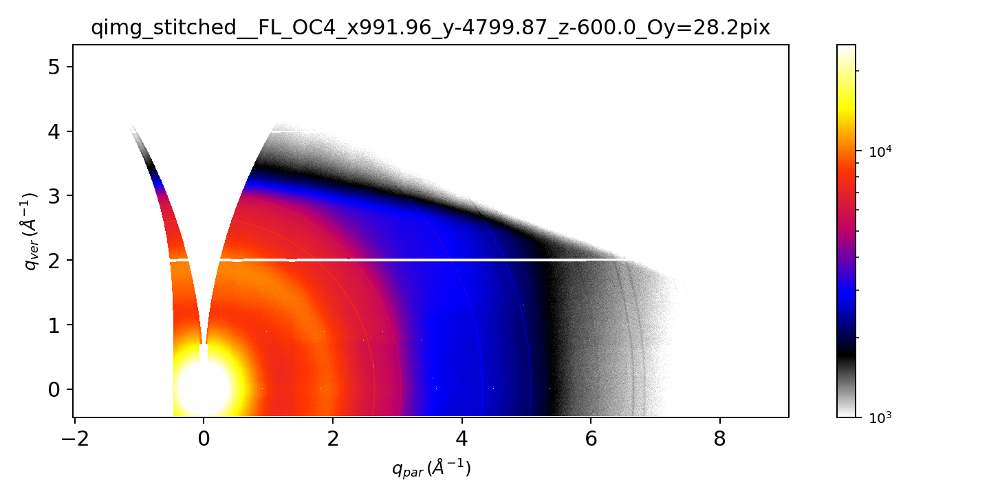

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


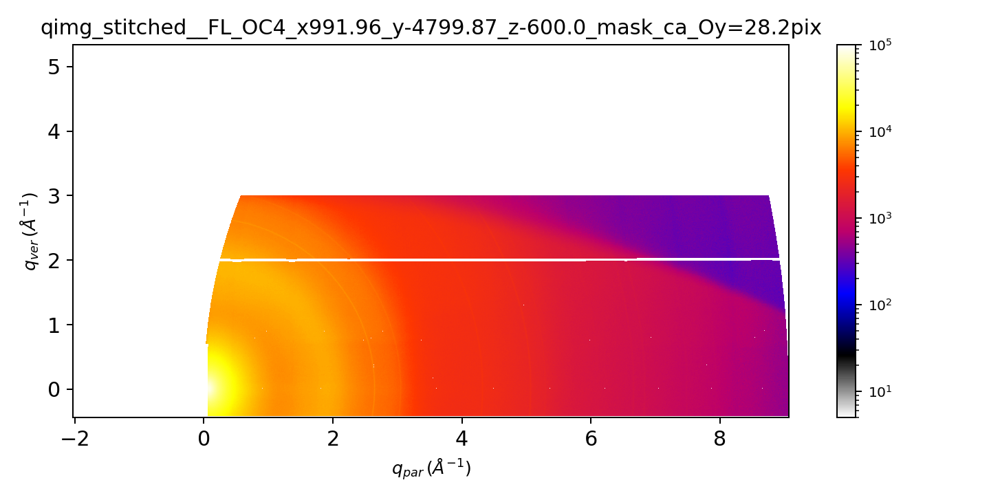

<IPython.core.display.Javascript object>


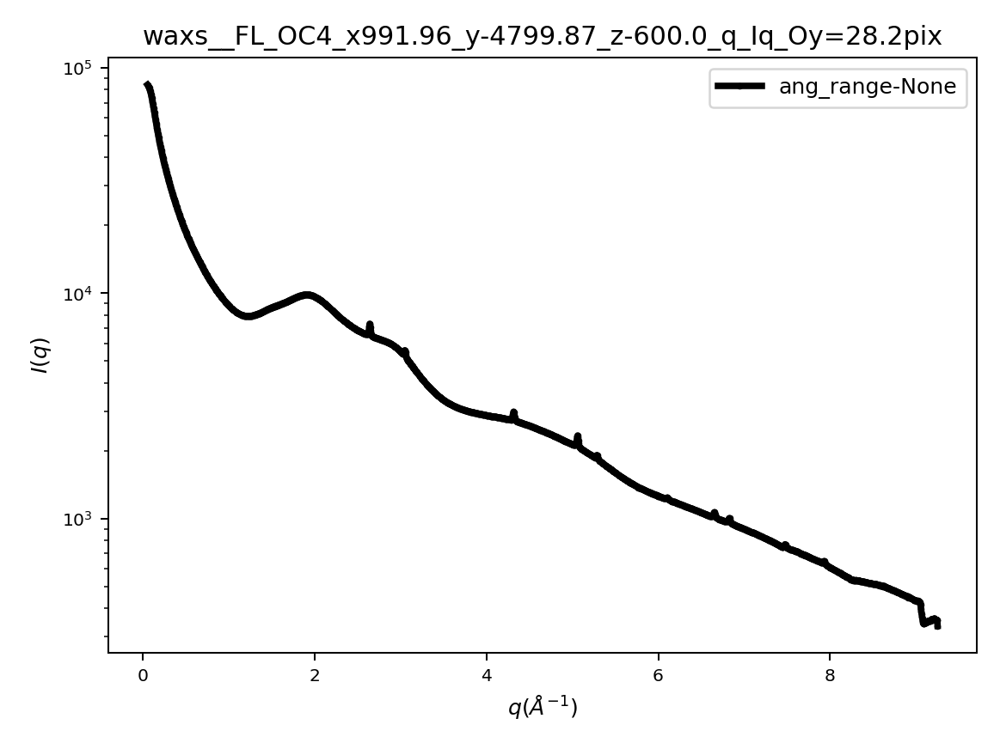

2.6685292985643927


<IPython.core.display.Javascript object>


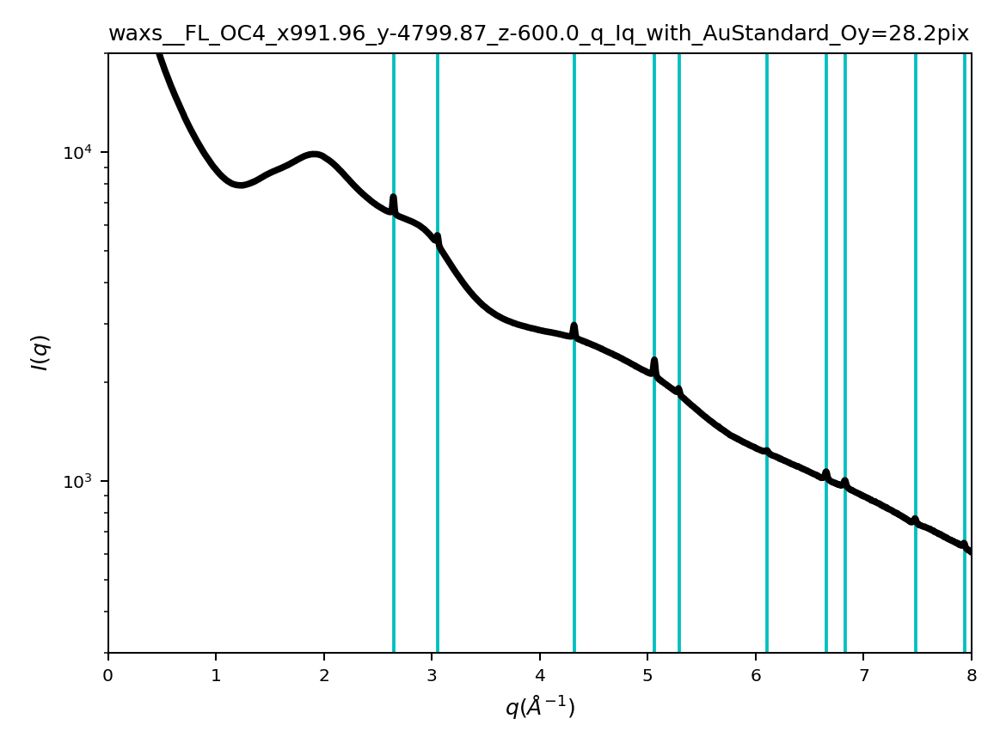

The sample is: 4.
['_FL_OC4_x991.92_y-4799.88_z400.0_waxsP00.00_expt1s_attNone_sid00136326_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.86_z400.0_waxsP06.50_expt1s_attNone_sid00136356_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.86_z400.0_waxsP13.00_expt1s_attNone_sid00136386_000001_WAXS.tif', '_FL_OC4_x991.93_y-4799.82_z400.0_waxsP19.50_expt1s_attNone_sid00136416_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.86_z400.0_waxsP26.00_expt1s_attNone_sid00136446_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.92_z400.0_waxsP32.50_expt1s_attNone_sid00136476_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.87_z400.0_waxsP39.00_expt1s_attNone_sid00136506_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.87_z400.0_waxsP45.50_expt1s_attNone_sid00136536_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.86_z400.0_waxsP52.00_expt1s_attNone_sid00136566_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.86_z400.0_waxsP58.50_expt1s_attNone_sid00136596_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.87_z400.0_waxsP65.00_expt1s_attNone_sid00136626_000001_WA

<IPython.core.display.Javascript object>


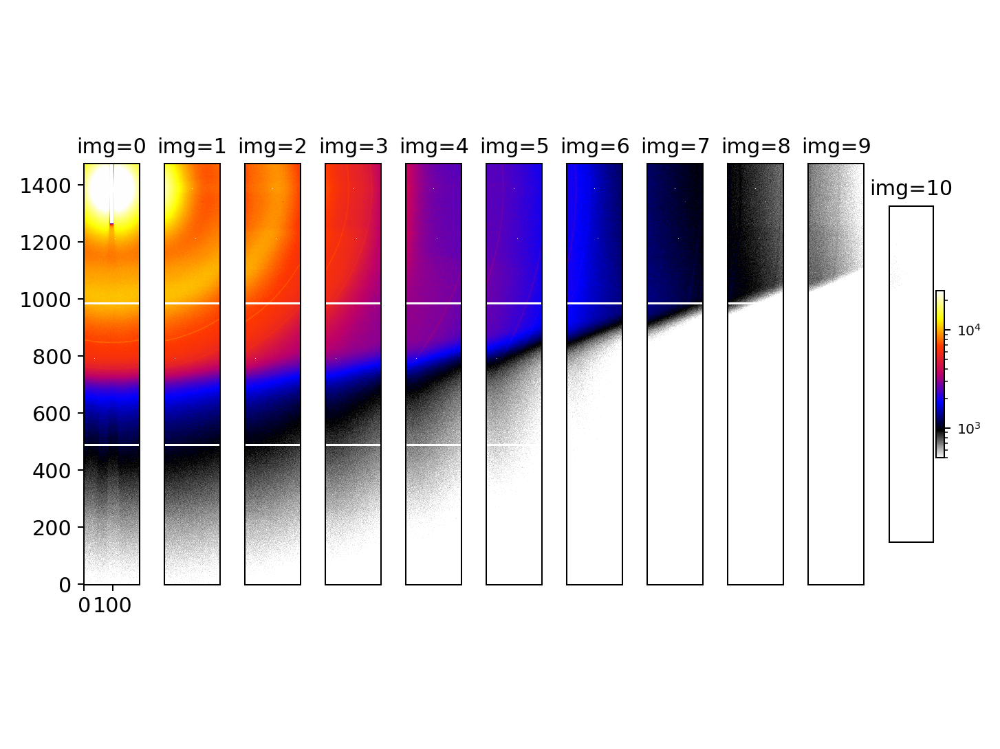

<IPython.core.display.Javascript object>


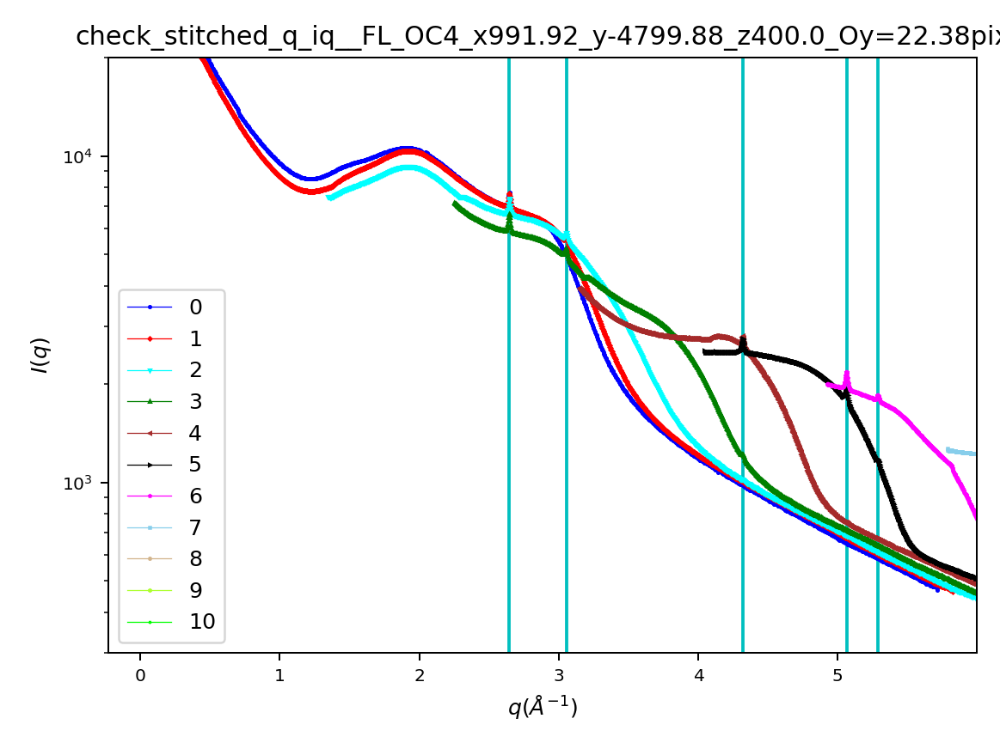

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


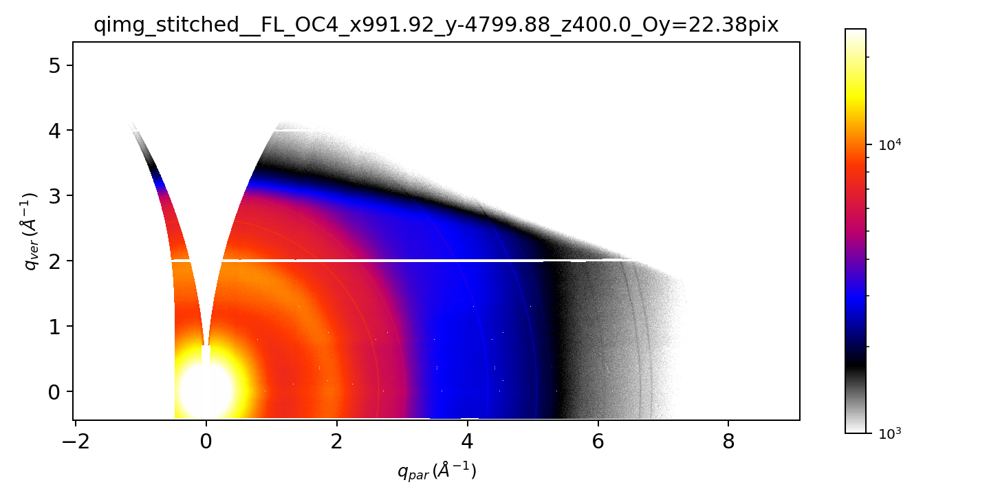

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


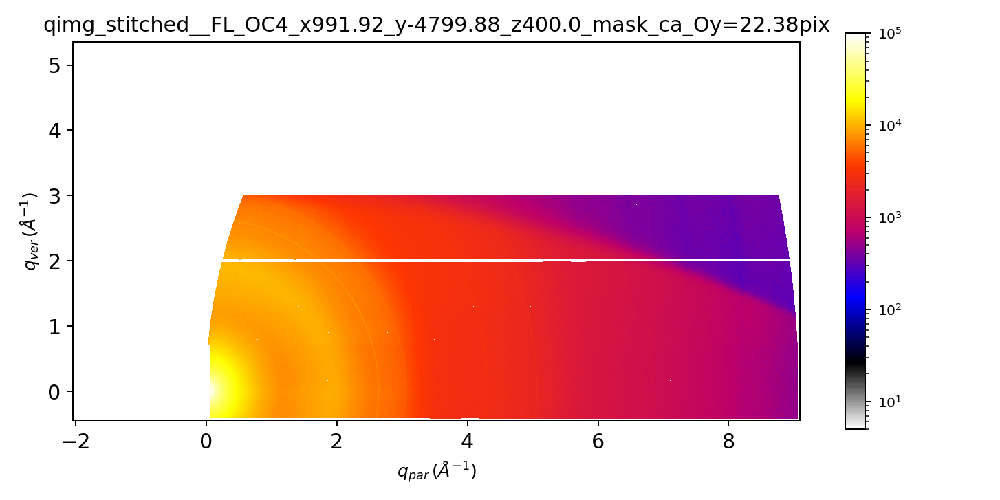

<IPython.core.display.Javascript object>


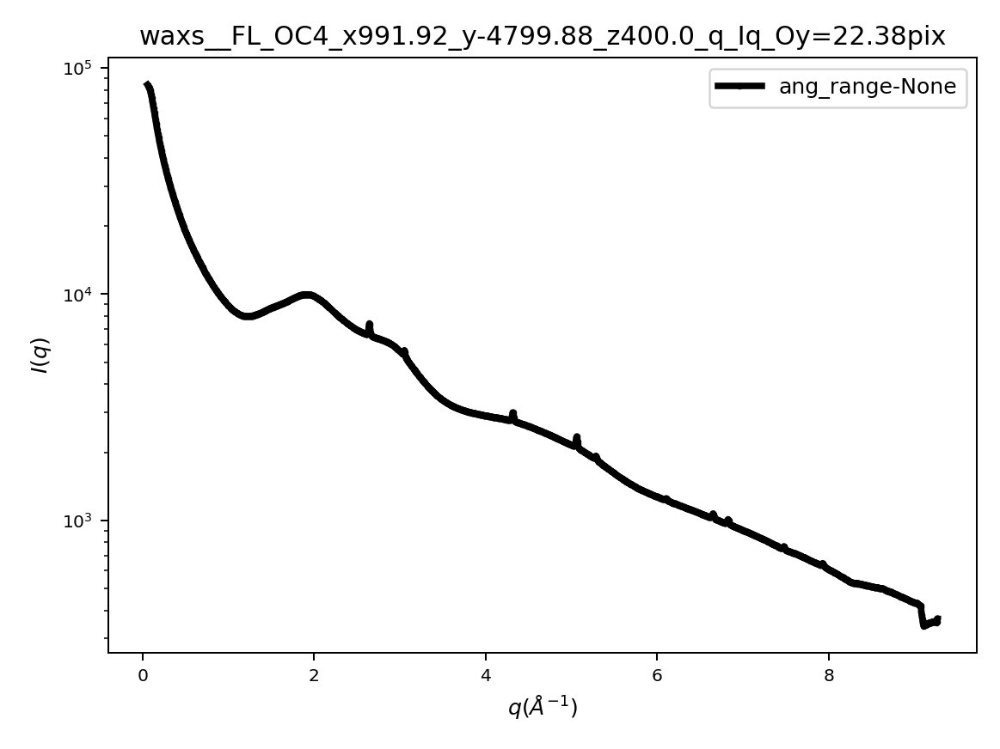

2.6685292985643927


<IPython.core.display.Javascript object>


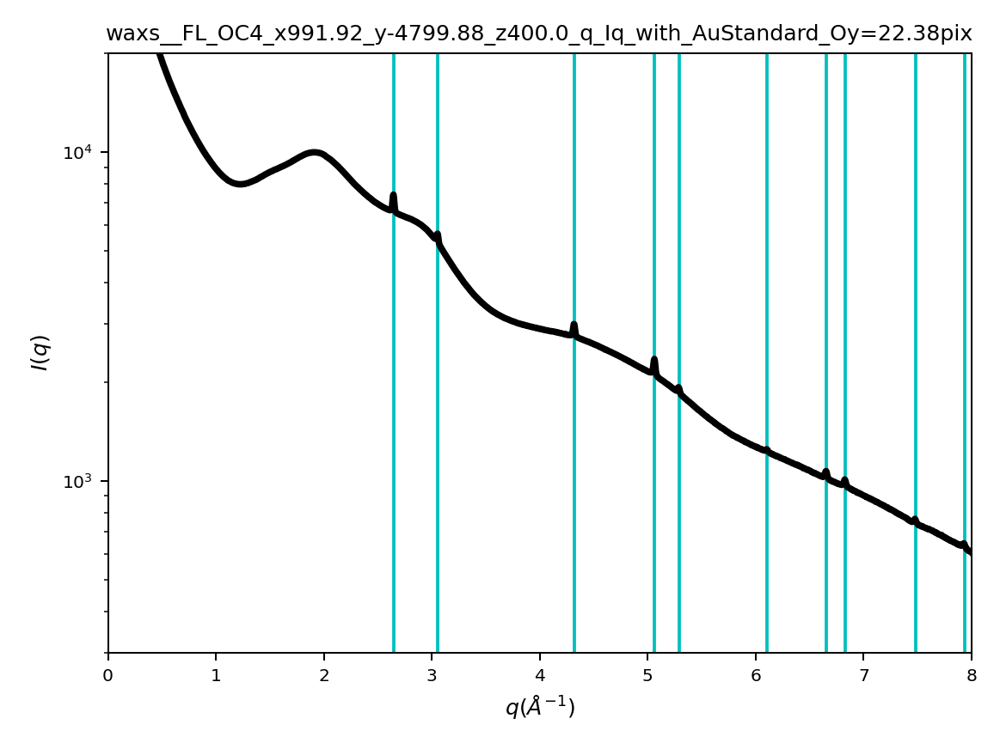

The sample is: 5.
['_FL_OC4_x991.96_y-4799.89_z900.0_waxsP00.00_expt1s_attNone_sid00136327_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.88_z900.0_waxsP06.50_expt1s_attNone_sid00136357_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.79_z900.0_waxsP13.00_expt1s_attNone_sid00136387_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.88_z900.0_waxsP19.50_expt1s_attNone_sid00136417_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.88_z900.0_waxsP26.00_expt1s_attNone_sid00136447_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.88_z900.0_waxsP32.50_expt1s_attNone_sid00136477_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.89_z900.0_waxsP39.00_expt1s_attNone_sid00136507_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.88_z900.0_waxsP45.50_expt1s_attNone_sid00136537_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.89_z900.0_waxsP52.00_expt1s_attNone_sid00136567_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.88_z900.0_waxsP58.50_expt1s_attNone_sid00136597_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.88_z900.0_waxsP65.00_expt1s_attNone_sid00136627_000001_WA

<IPython.core.display.Javascript object>


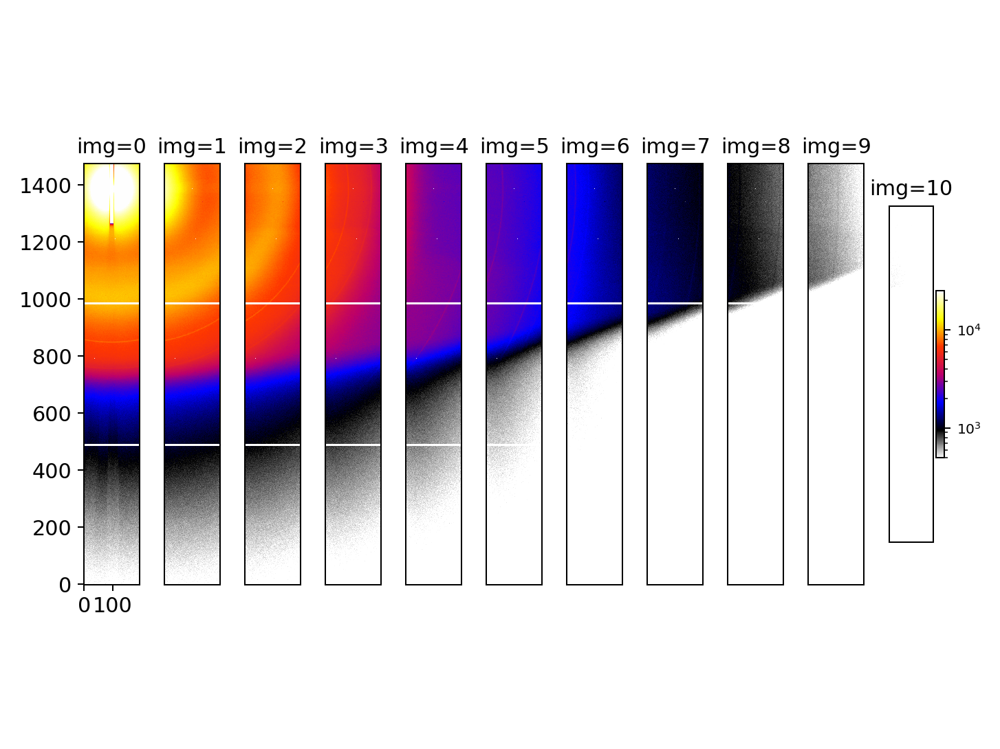

<IPython.core.display.Javascript object>


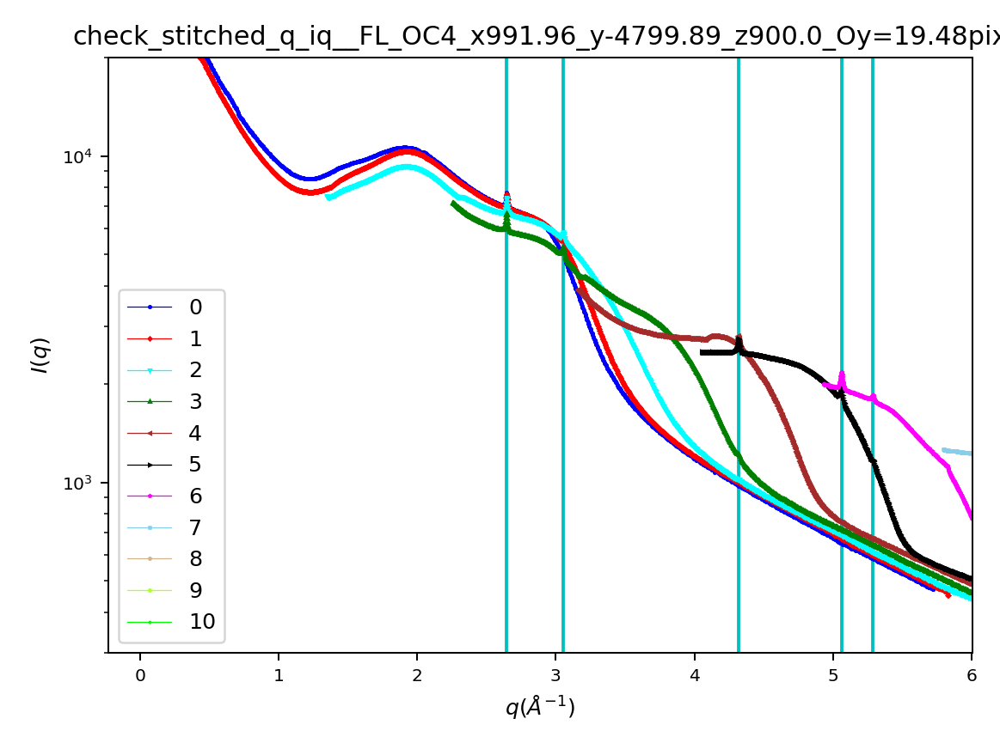

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


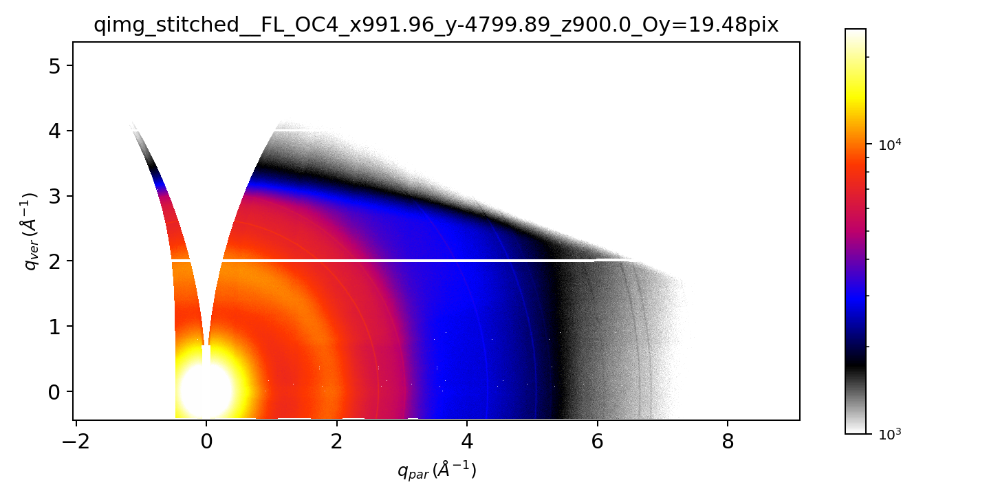

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


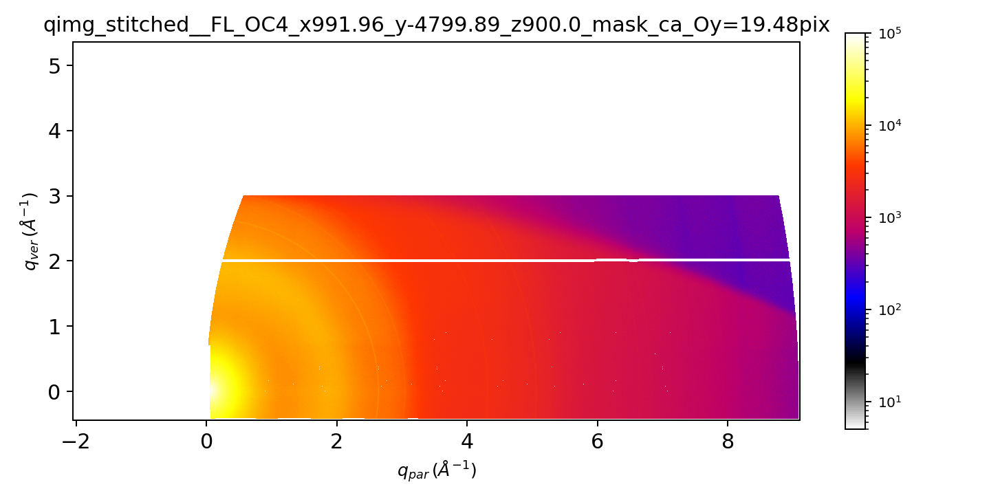

<IPython.core.display.Javascript object>


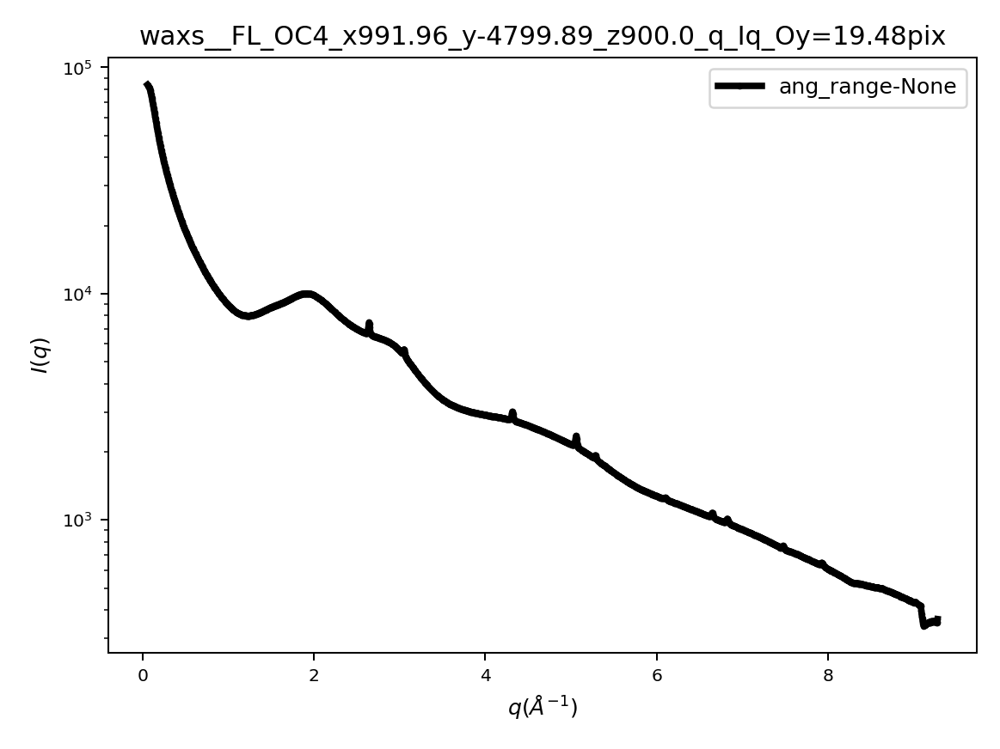

2.6685292985643927


<IPython.core.display.Javascript object>


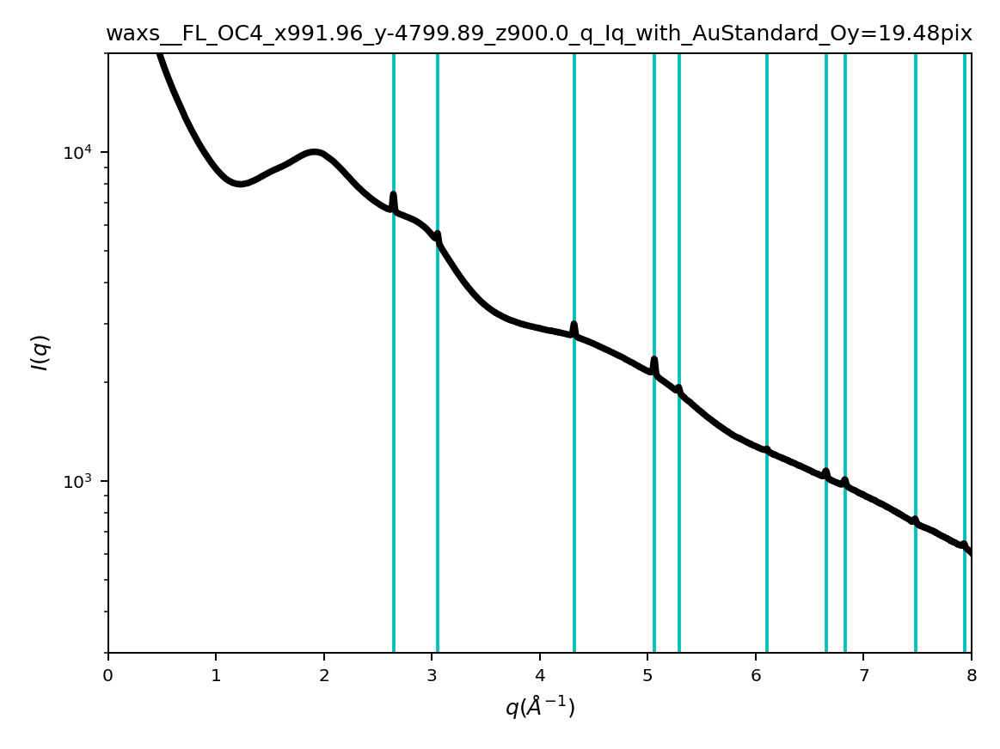

The sample is: 6.
['_FL_OC4_x991.96_y-4799.92_z1150.01_waxsP00.00_expt1s_attNone_sid00136328_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.94_z1150.0_waxsP06.50_expt1s_attNone_sid00136358_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.88_z1149.99_waxsP13.00_expt1s_attNone_sid00136388_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.89_z1150.0_waxsP19.50_expt1s_attNone_sid00136418_000001_WAXS.tif', '_FL_OC4_x991.99_y-4799.87_z1150.0_waxsP26.00_expt1s_attNone_sid00136448_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.81_z1150.0_waxsP32.50_expt1s_attNone_sid00136478_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.93_z1149.99_waxsP39.00_expt1s_attNone_sid00136508_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.89_z1150.0_waxsP45.50_expt1s_attNone_sid00136538_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.89_z1150.0_waxsP52.00_expt1s_attNone_sid00136568_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.88_z1150.01_waxsP58.50_expt1s_attNone_sid00136598_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.93_z1150.0_waxsP65.00_expt1s_attNone_sid001

<IPython.core.display.Javascript object>


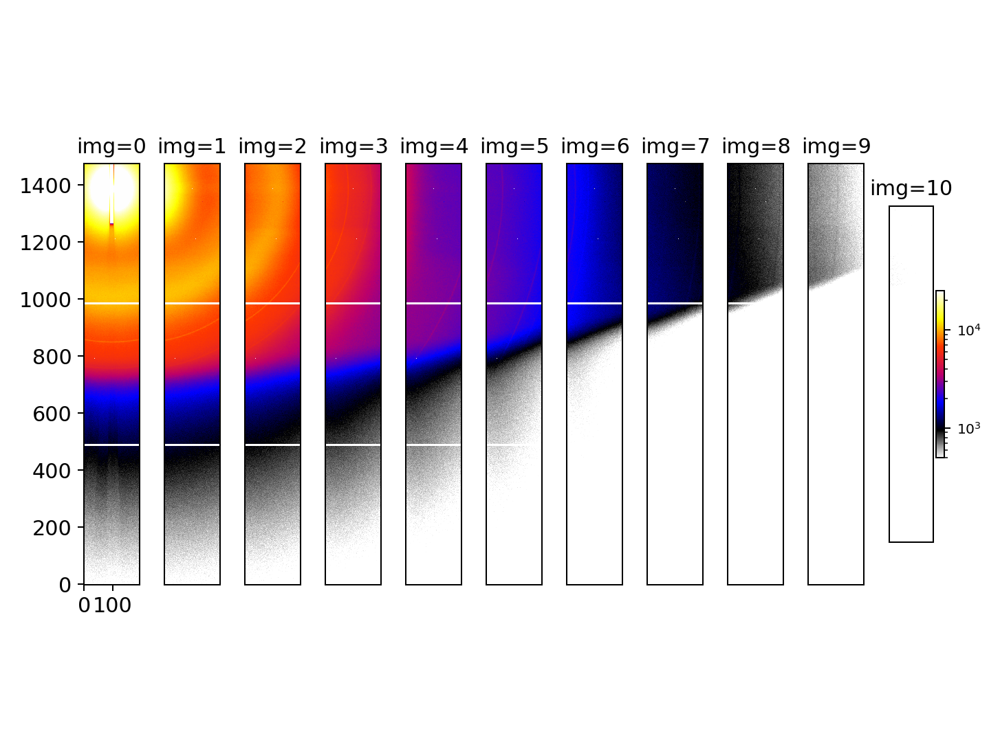

<IPython.core.display.Javascript object>


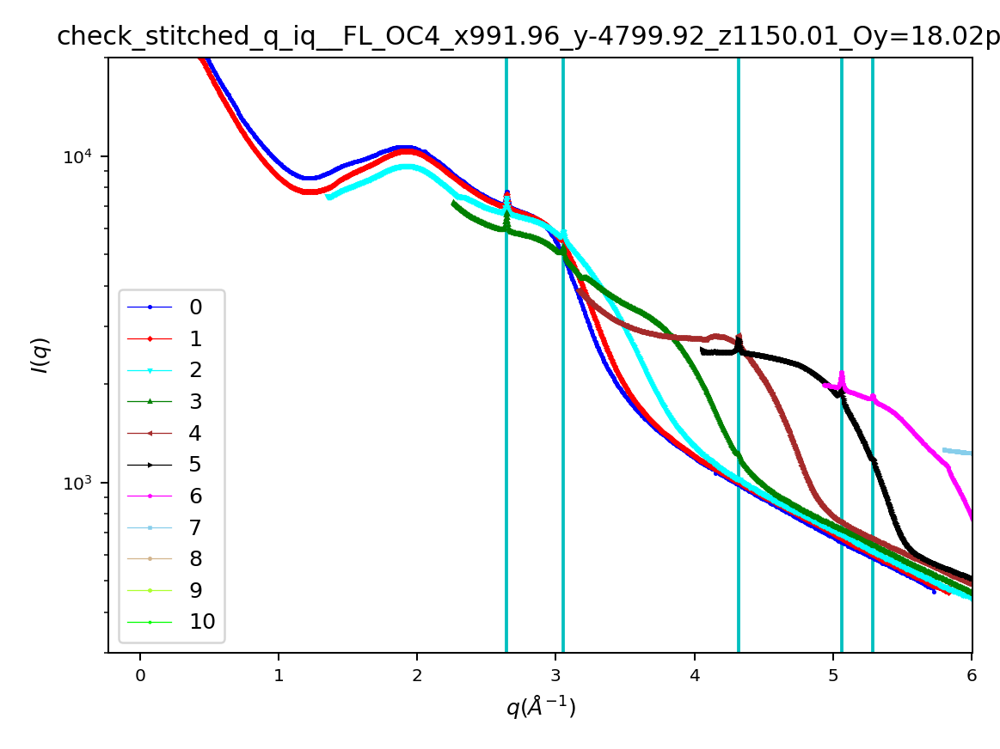

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


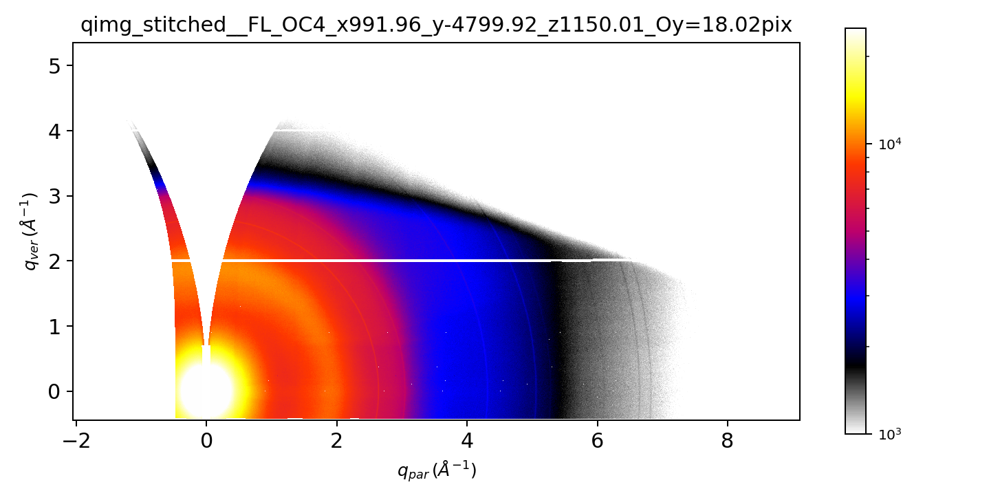

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


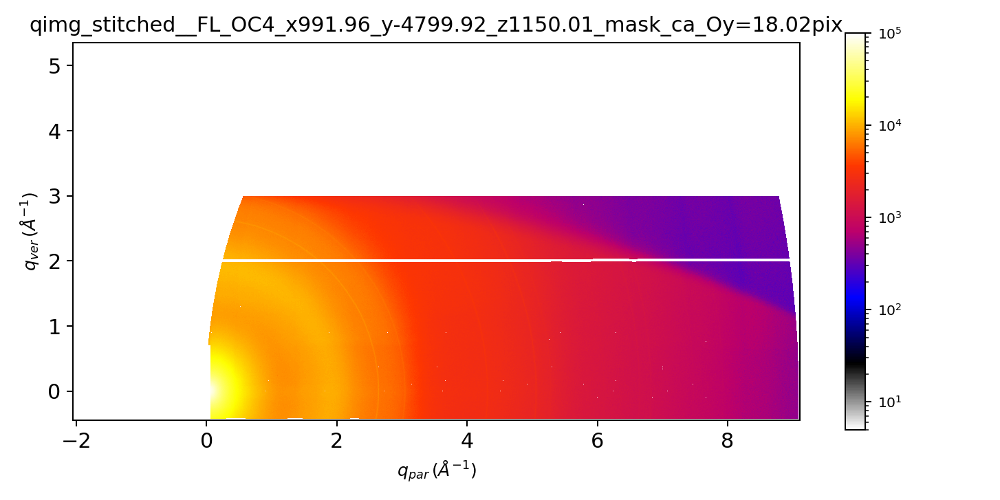

<IPython.core.display.Javascript object>


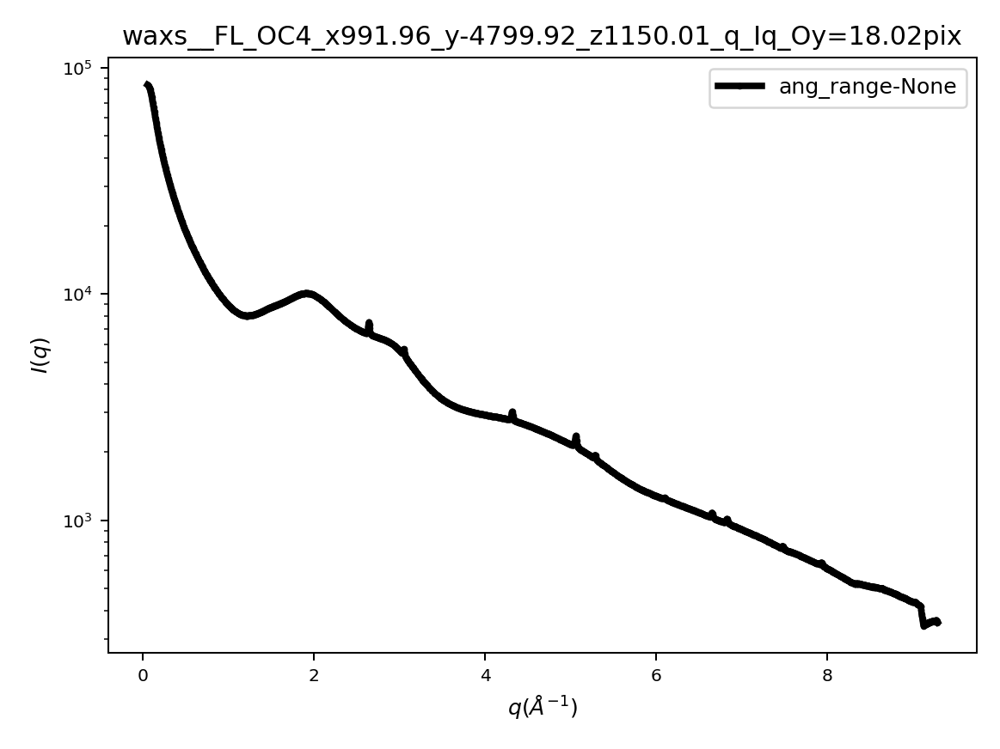

2.6685292985643927


<IPython.core.display.Javascript object>


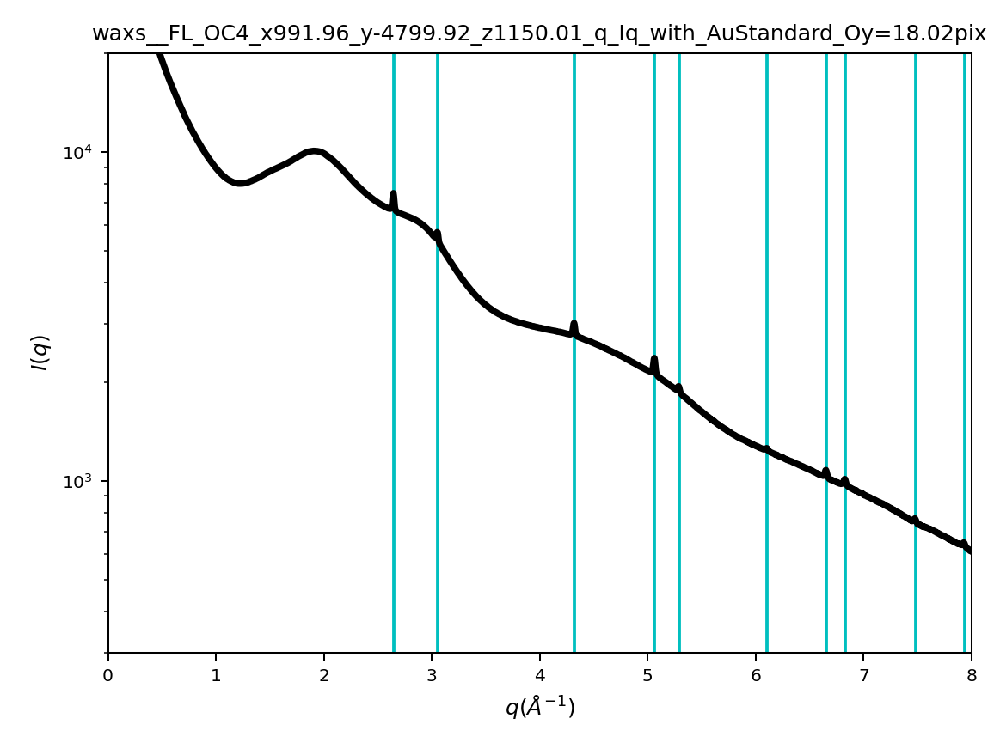

The sample is: 7.
['_FL_OC4_x991.96_y-4799.9_z1400.0_waxsP00.00_expt1s_attNone_sid00136329_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.88_z1400.0_waxsP06.50_expt1s_attNone_sid00136359_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.89_z1400.01_waxsP13.00_expt1s_attNone_sid00136389_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.9_z1400.01_waxsP19.50_expt1s_attNone_sid00136419_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.88_z1400.0_waxsP26.00_expt1s_attNone_sid00136449_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.88_z1400.0_waxsP32.50_expt1s_attNone_sid00136479_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.89_z1400.0_waxsP39.00_expt1s_attNone_sid00136509_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.8_z1400.0_waxsP45.50_expt1s_attNone_sid00136539_000001_WAXS.tif', '_FL_OC4_x991.94_y-4800.06_z1400.0_waxsP52.00_expt1s_attNone_sid00136569_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.9_z1400.01_waxsP58.50_expt1s_attNone_sid00136599_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.88_z1400.0_waxsP65.00_expt1s_attNone_sid00136629

<IPython.core.display.Javascript object>


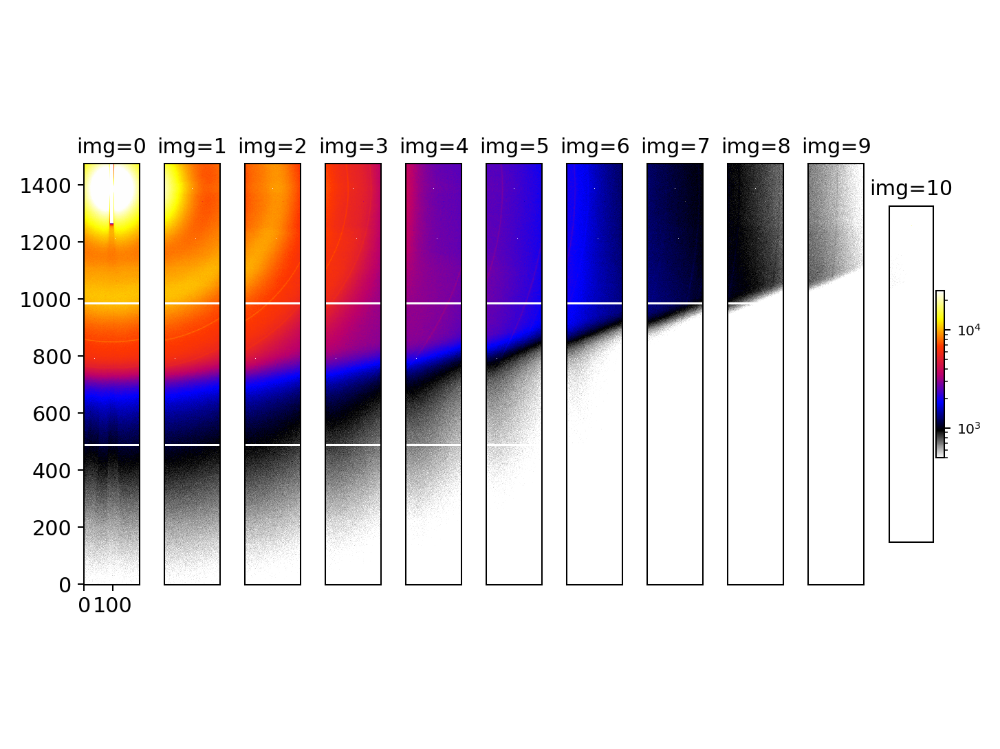

<IPython.core.display.Javascript object>


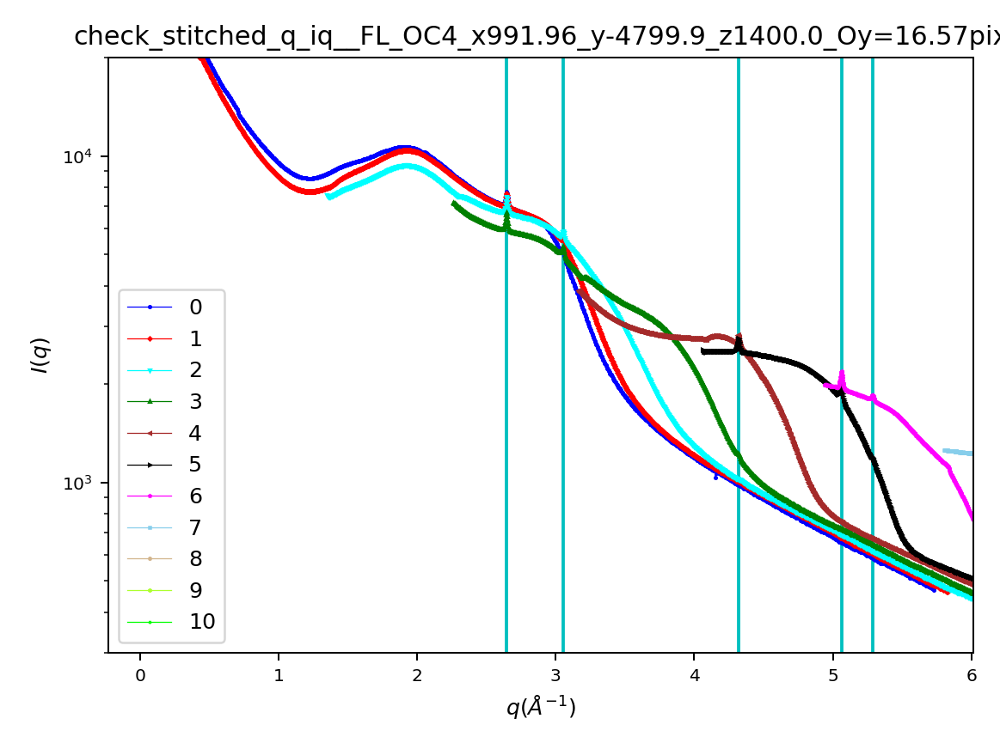

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


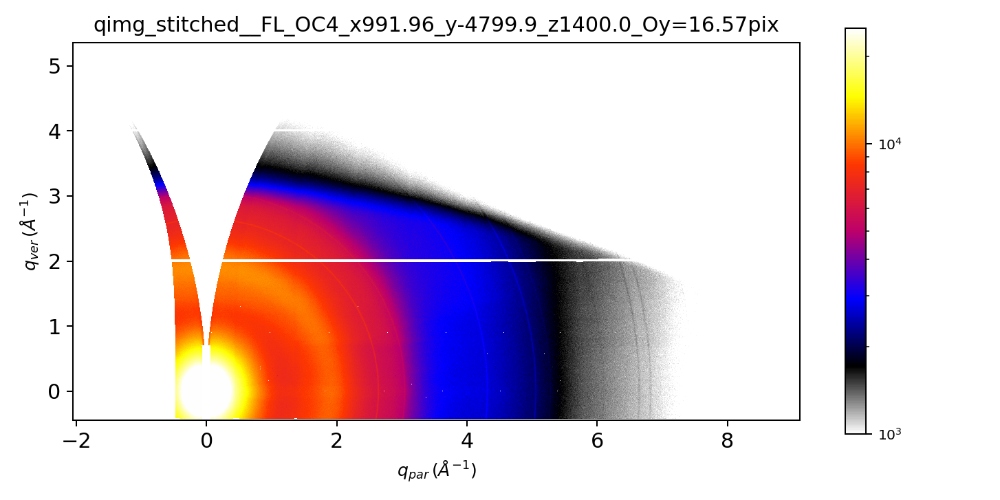

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


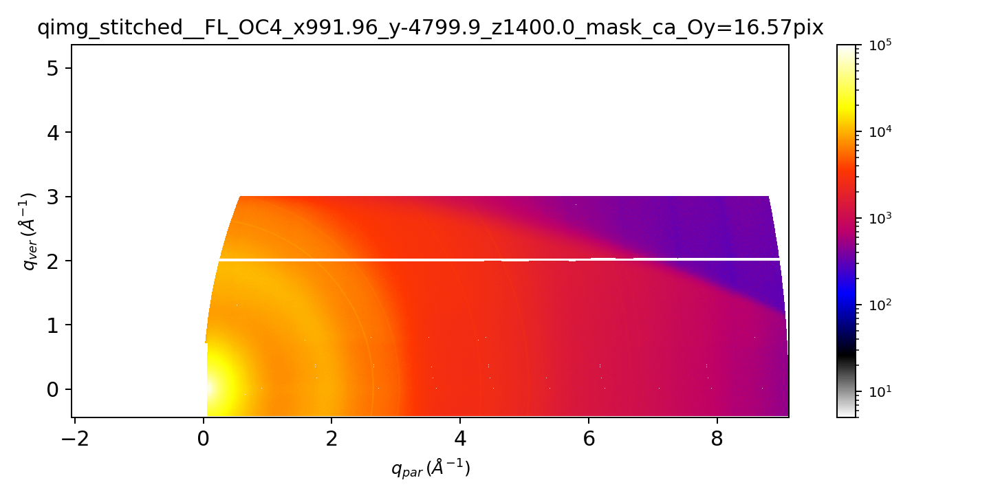

<IPython.core.display.Javascript object>


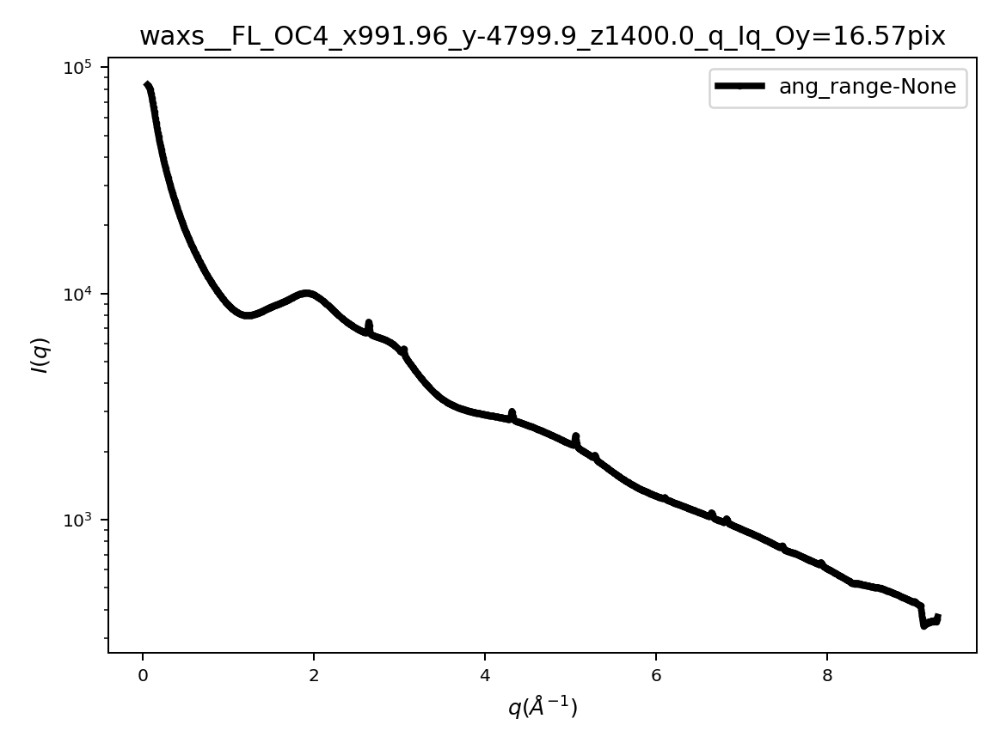

2.6685292985643927


<IPython.core.display.Javascript object>


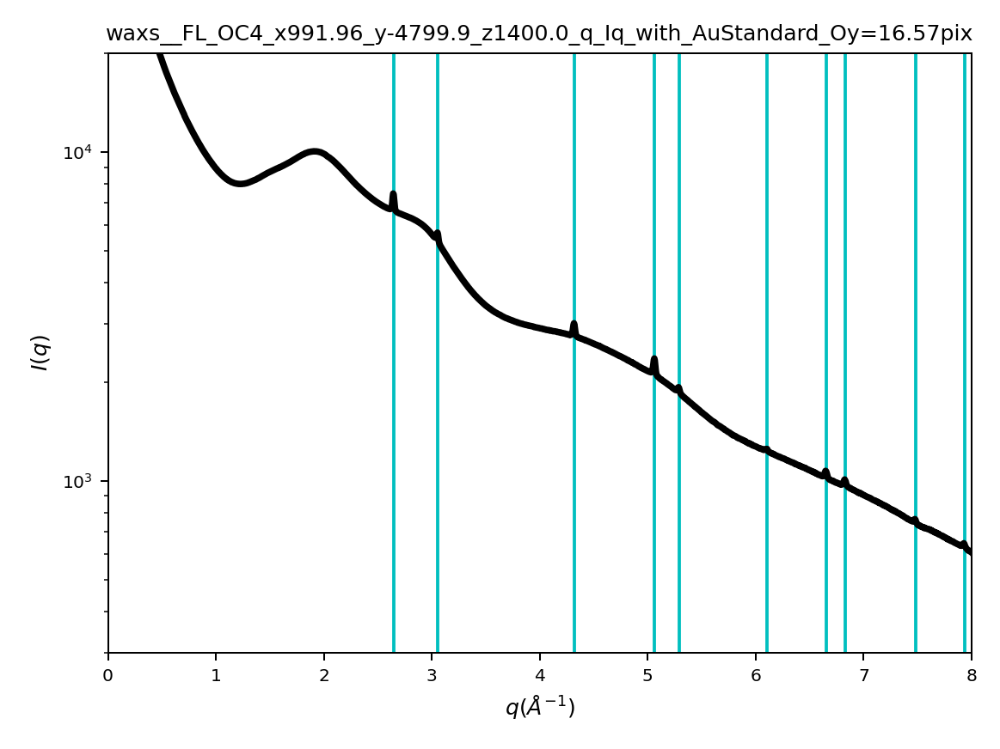

The sample is: 8.
['_FL_OC4_x991.96_y-4799.97_z1650.0_waxsP00.00_expt1s_attNone_sid00136330_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.89_z1650.0_waxsP06.50_expt1s_attNone_sid00136360_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.9_z1650.0_waxsP13.00_expt1s_attNone_sid00136390_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.82_z1650.0_waxsP19.50_expt1s_attNone_sid00136420_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.86_z1650.0_waxsP26.00_expt1s_attNone_sid00136450_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.82_z1650.0_waxsP32.50_expt1s_attNone_sid00136480_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.9_z1650.0_waxsP39.00_expt1s_attNone_sid00136510_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.89_z1650.0_waxsP45.50_expt1s_attNone_sid00136540_000001_WAXS.tif', '_FL_OC4_x991.94_y-4800.01_z1650.0_waxsP52.00_expt1s_attNone_sid00136570_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.89_z1650.0_waxsP58.50_expt1s_attNone_sid00136600_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.89_z1650.01_waxsP65.00_expt1s_attNone_sid00136630

<IPython.core.display.Javascript object>


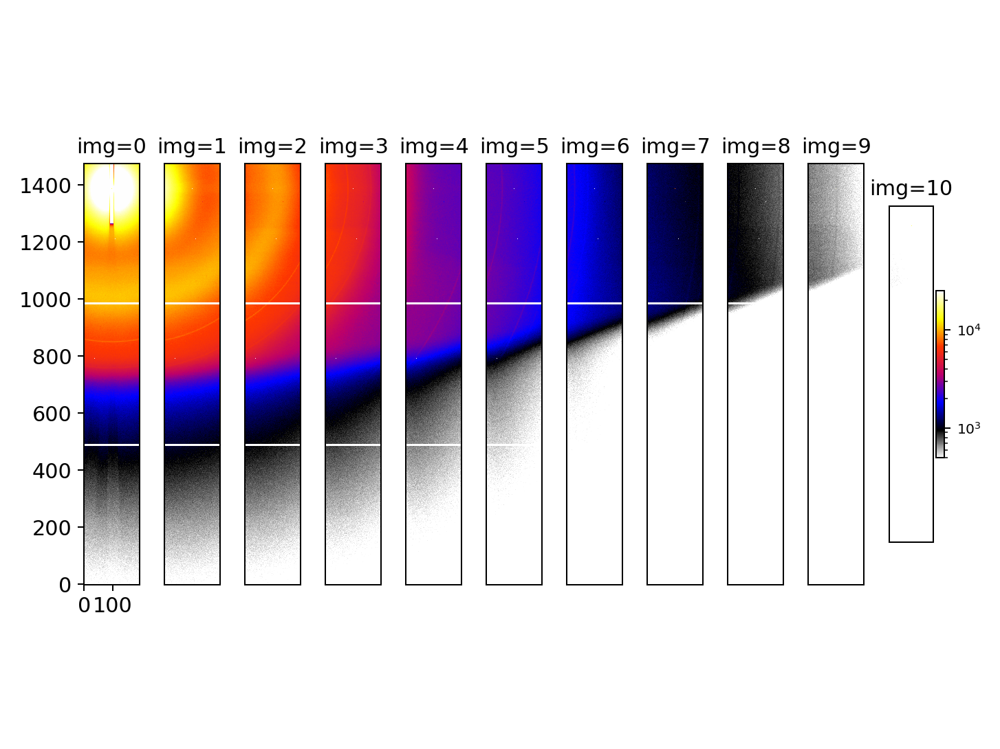

<IPython.core.display.Javascript object>


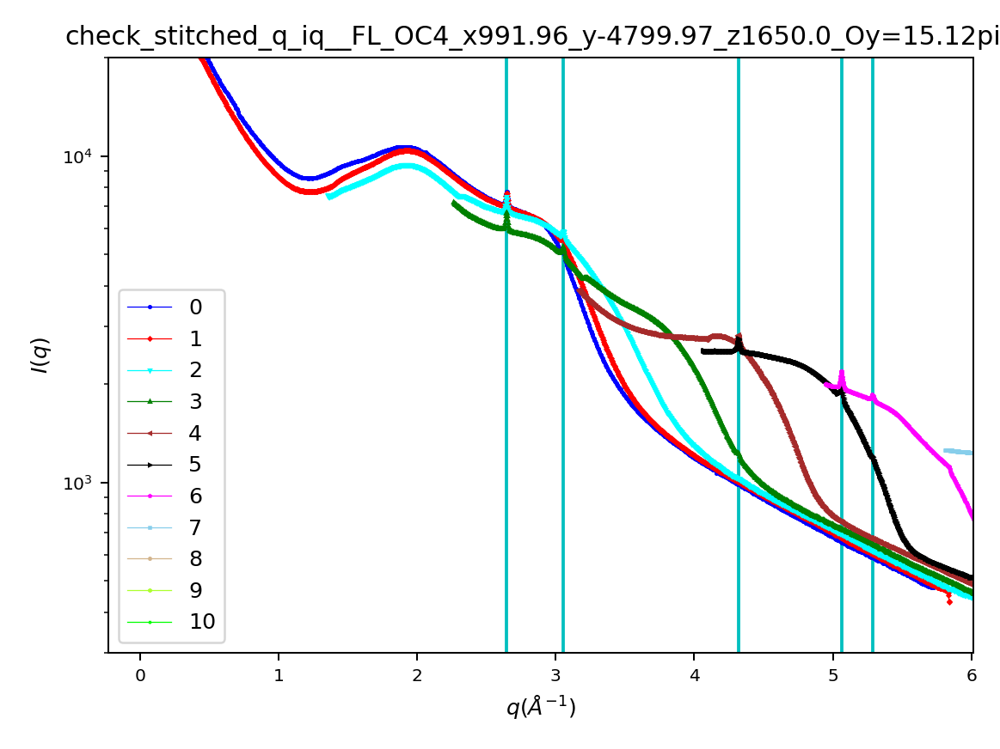

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


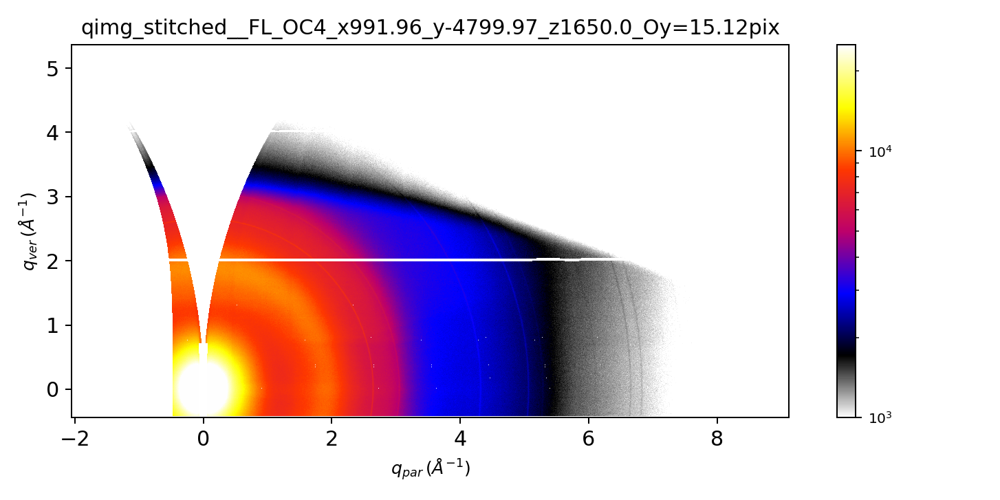

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


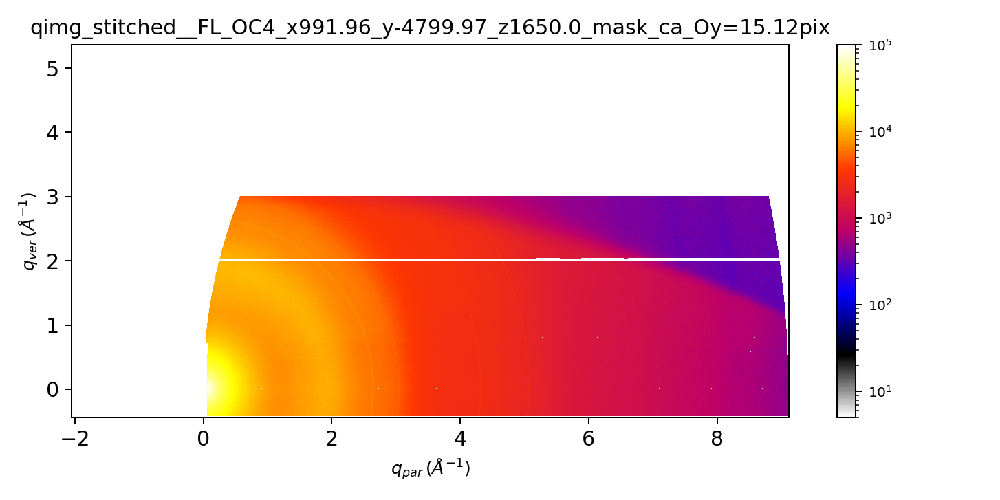

<IPython.core.display.Javascript object>


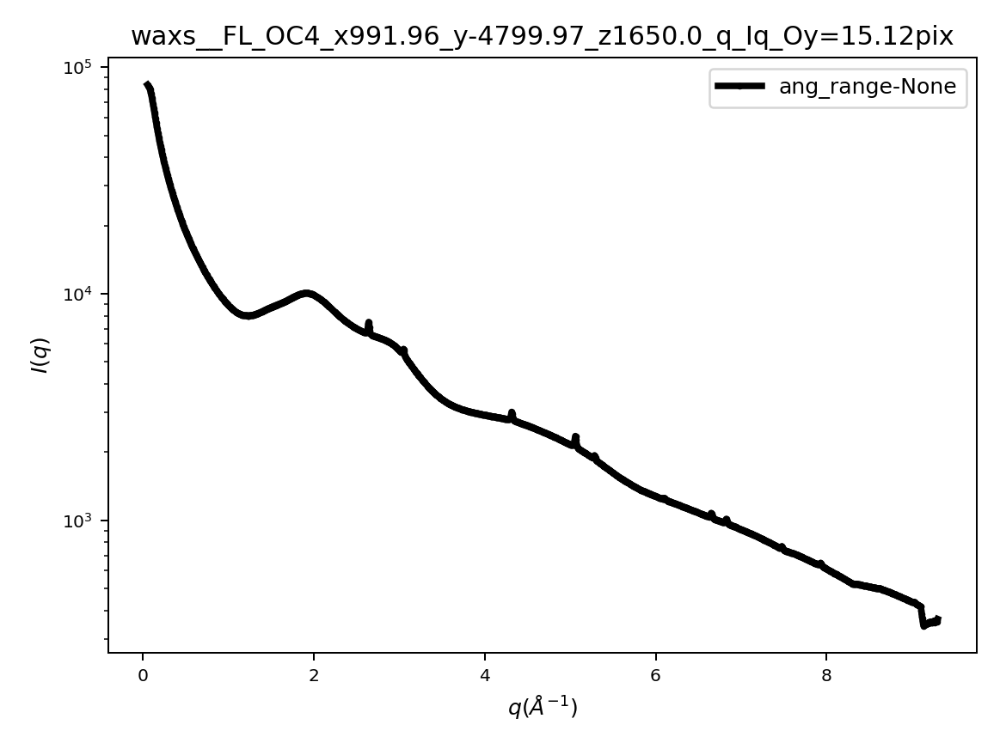

2.6685292985643927


<IPython.core.display.Javascript object>


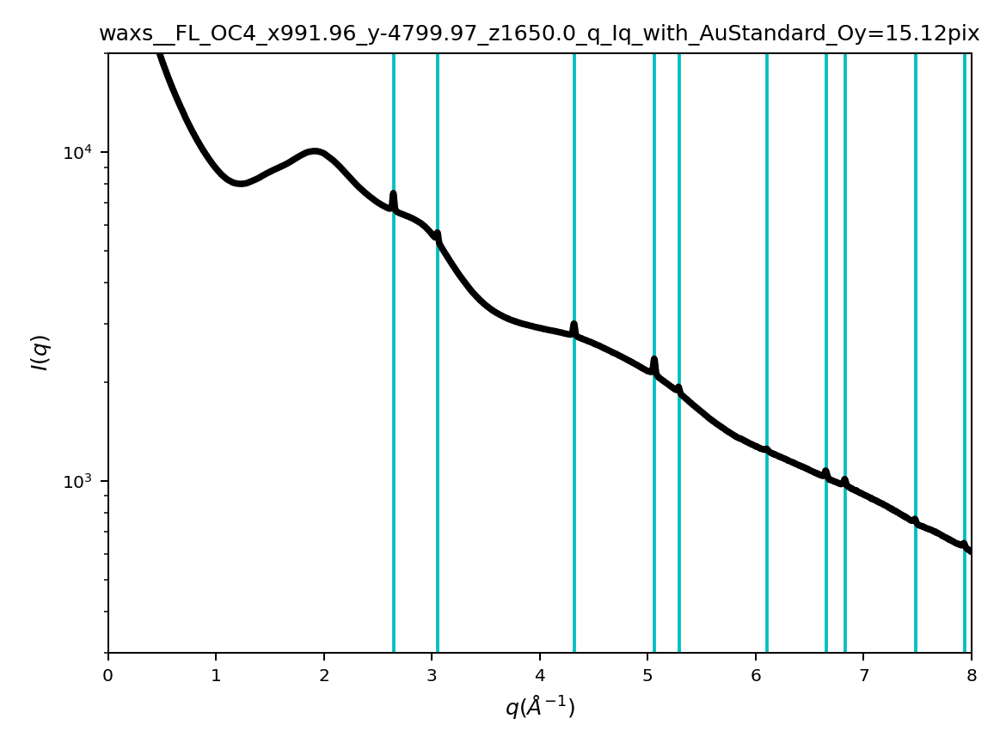

The sample is: 9.
['_FL_OC4_x991.96_y-4799.91_z1900.01_waxsP00.00_expt1s_attNone_sid00136331_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.89_z1900.0_waxsP06.50_expt1s_attNone_sid00136361_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.89_z1900.0_waxsP13.00_expt1s_attNone_sid00136391_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.9_z1900.0_waxsP19.50_expt1s_attNone_sid00136421_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.89_z1900.0_waxsP26.00_expt1s_attNone_sid00136451_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.9_z1900.0_waxsP32.50_expt1s_attNone_sid00136481_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.91_z1900.01_waxsP39.00_expt1s_attNone_sid00136511_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.9_z1900.0_waxsP45.50_expt1s_attNone_sid00136541_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.89_z1900.0_waxsP52.00_expt1s_attNone_sid00136571_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.92_z1900.0_waxsP58.50_expt1s_attNone_sid00136601_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.89_z1900.01_waxsP65.00_expt1s_attNone_sid0013663

<IPython.core.display.Javascript object>


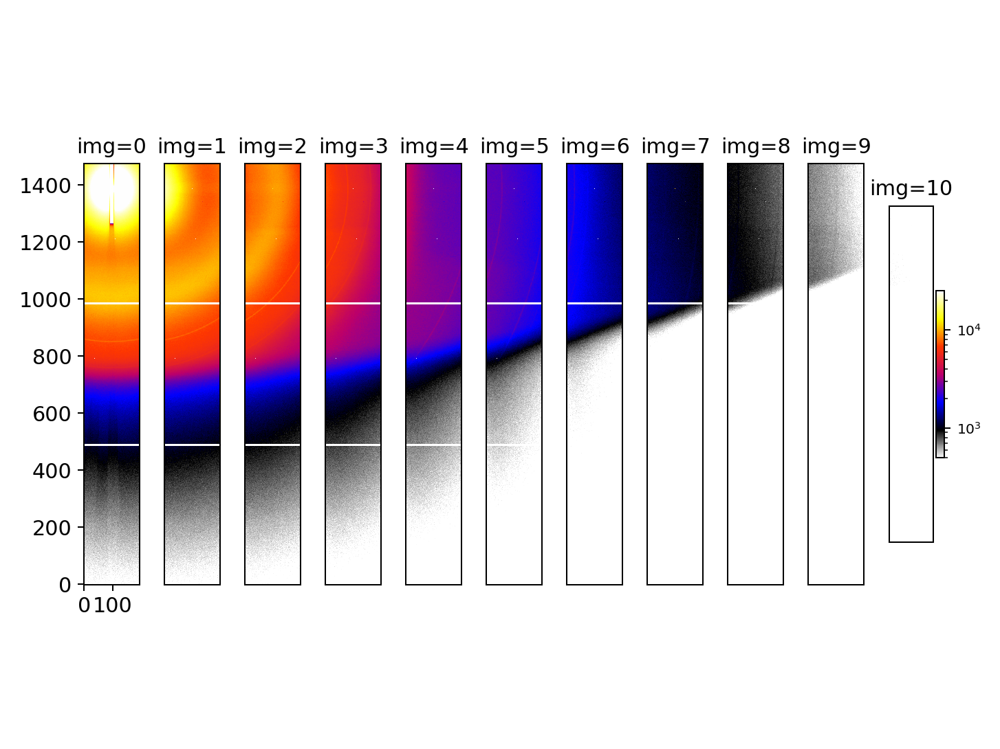

<IPython.core.display.Javascript object>


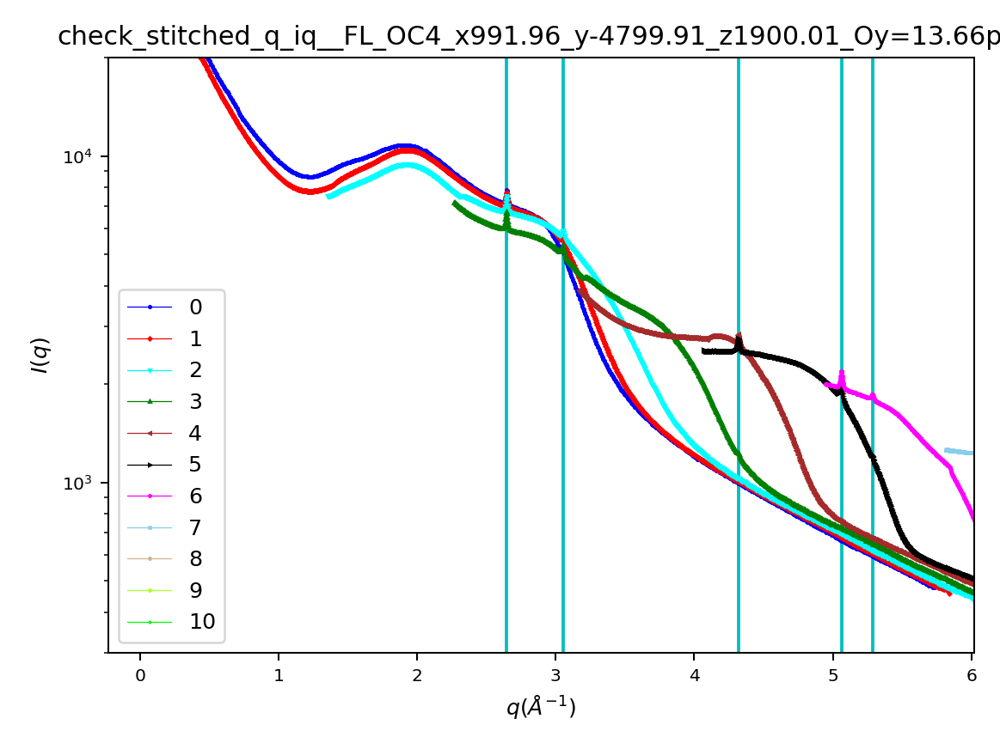

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


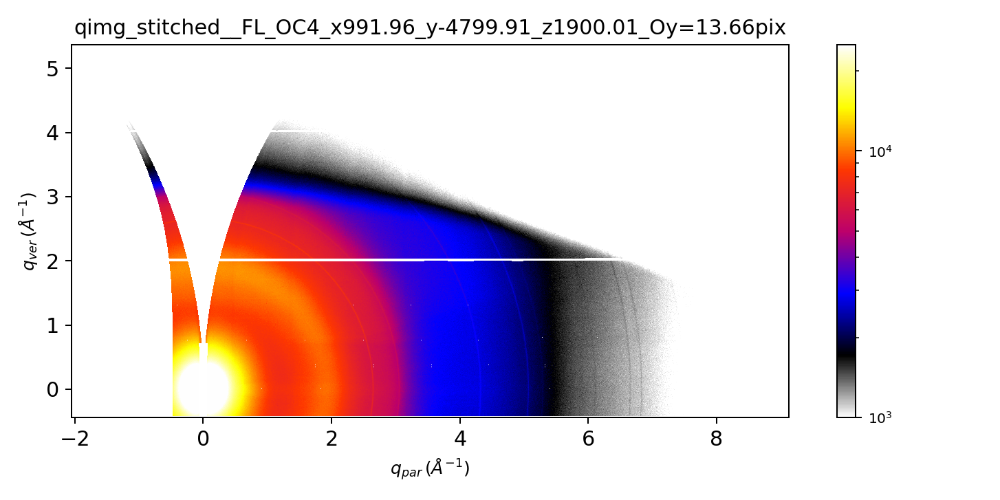

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


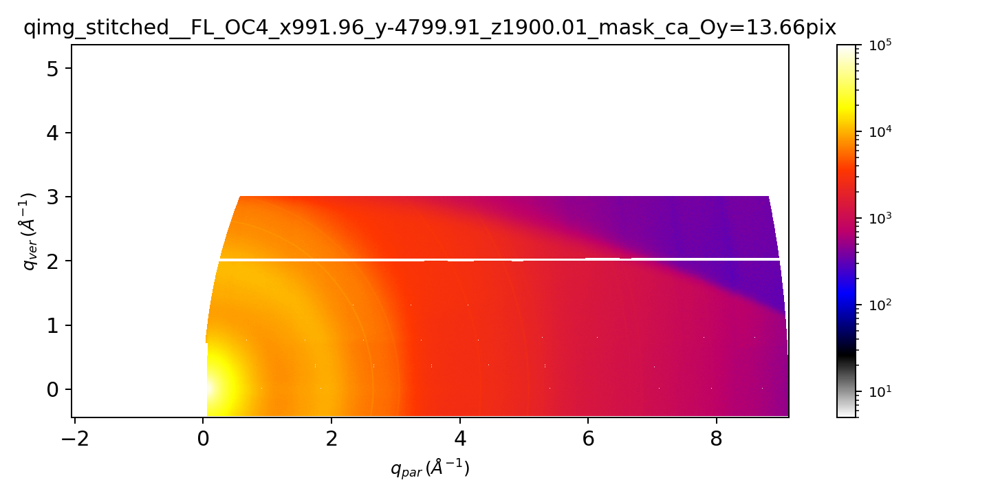

<IPython.core.display.Javascript object>


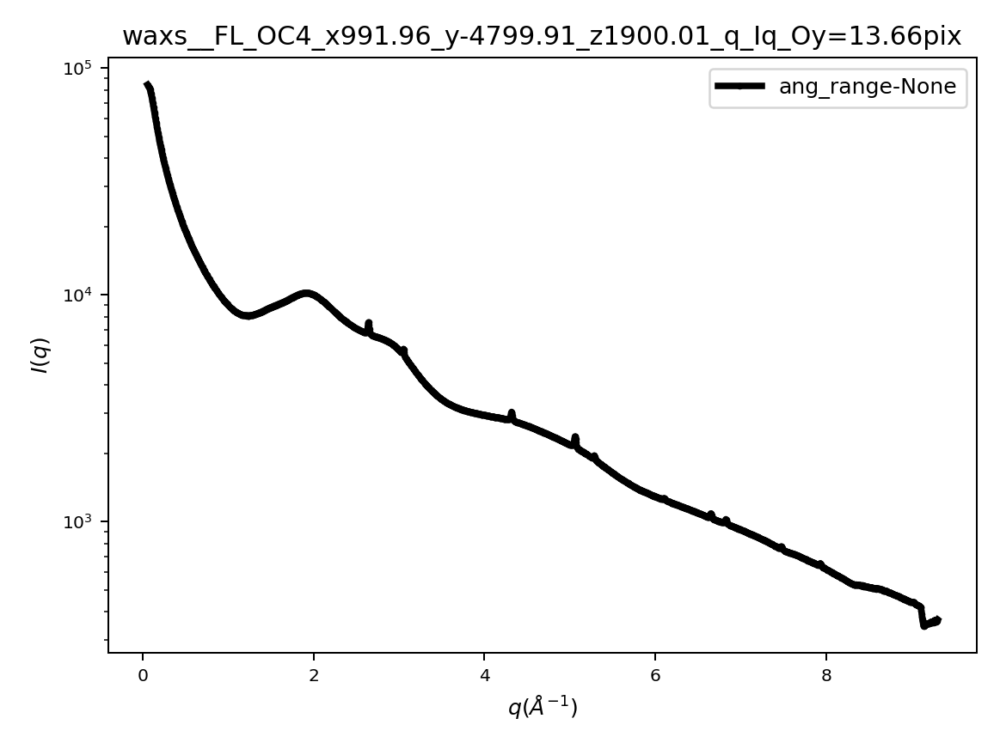

2.6685292985643927


<IPython.core.display.Javascript object>


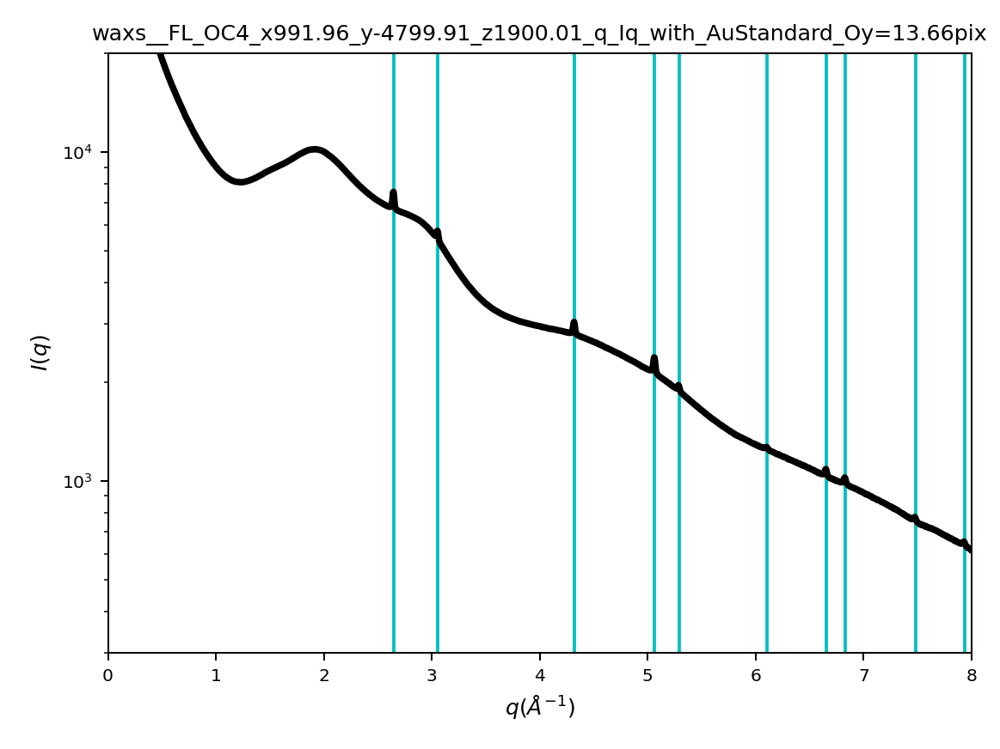

The sample is: 10.
['_FL_OC4_x991.97_y-4799.92_z2400.0_waxsP00.00_expt1s_attNone_sid00136332_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.96_z2400.0_waxsP06.50_expt1s_attNone_sid00136362_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.9_z2400.01_waxsP13.00_expt1s_attNone_sid00136392_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.9_z2400.0_waxsP19.50_expt1s_attNone_sid00136422_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.77_z2400.0_waxsP26.00_expt1s_attNone_sid00136452_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.9_z2400.0_waxsP32.50_expt1s_attNone_sid00136482_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.9_z2400.0_waxsP39.00_expt1s_attNone_sid00136512_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.9_z2400.0_waxsP45.50_expt1s_attNone_sid00136542_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.68_z2400.0_waxsP52.00_expt1s_attNone_sid00136572_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.9_z2400.01_waxsP58.50_expt1s_attNone_sid00136602_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.9_z2400.0_waxsP65.00_expt1s_attNone_sid00136632_00

<IPython.core.display.Javascript object>


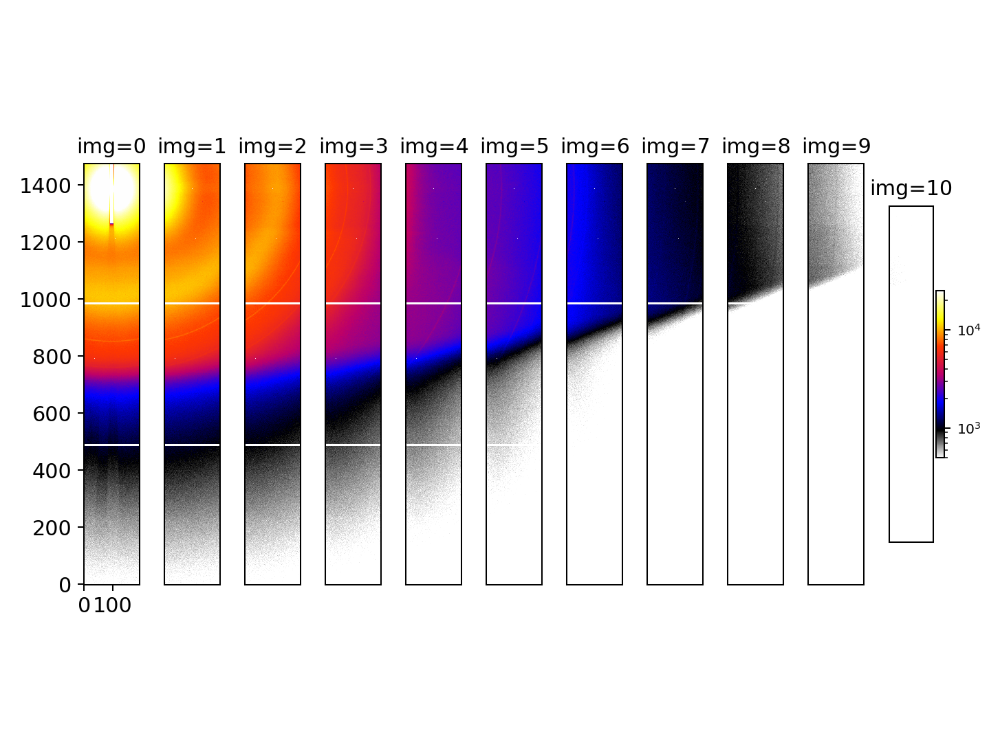

<IPython.core.display.Javascript object>


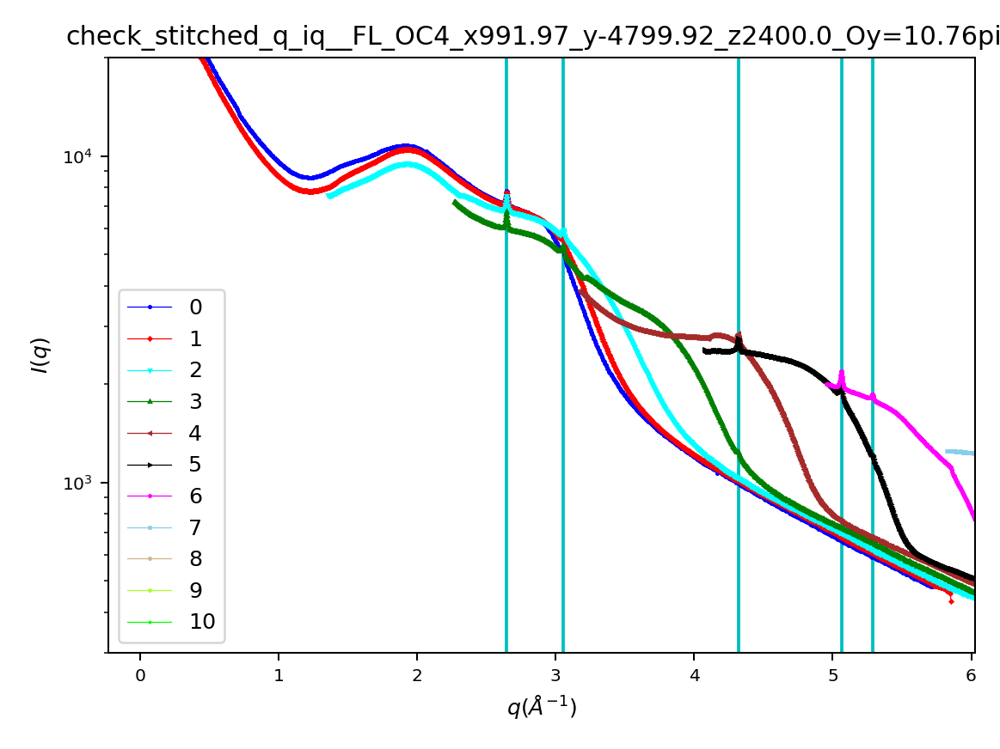

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


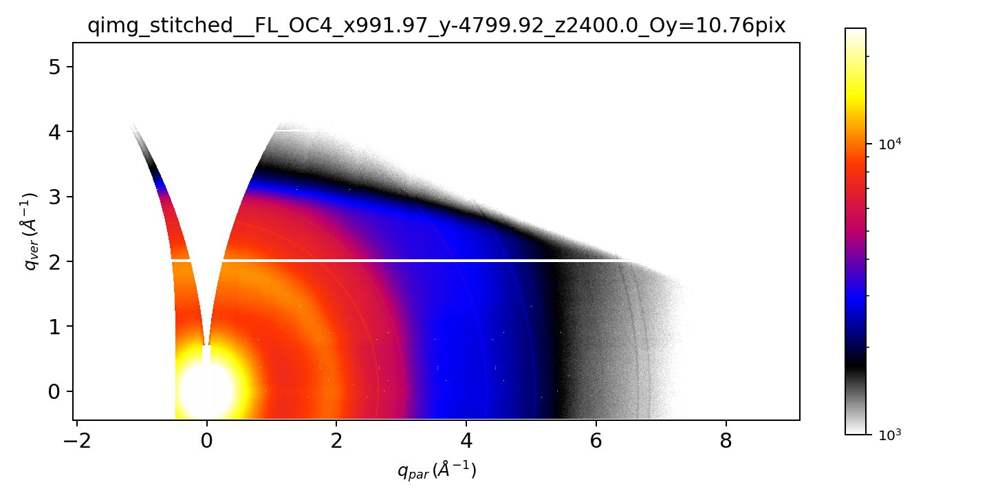

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


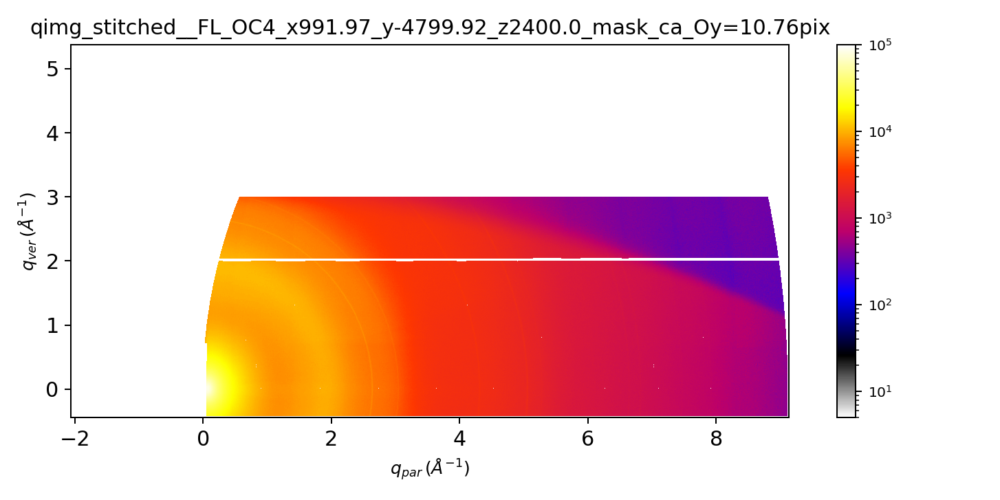

<IPython.core.display.Javascript object>


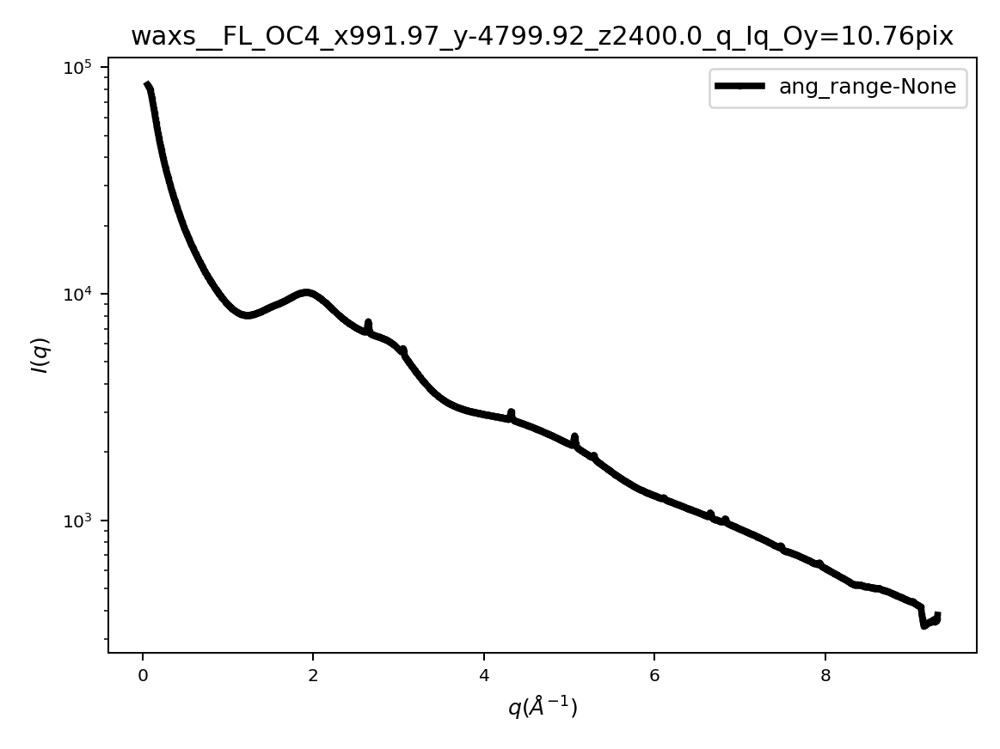

2.6685292985643927


<IPython.core.display.Javascript object>


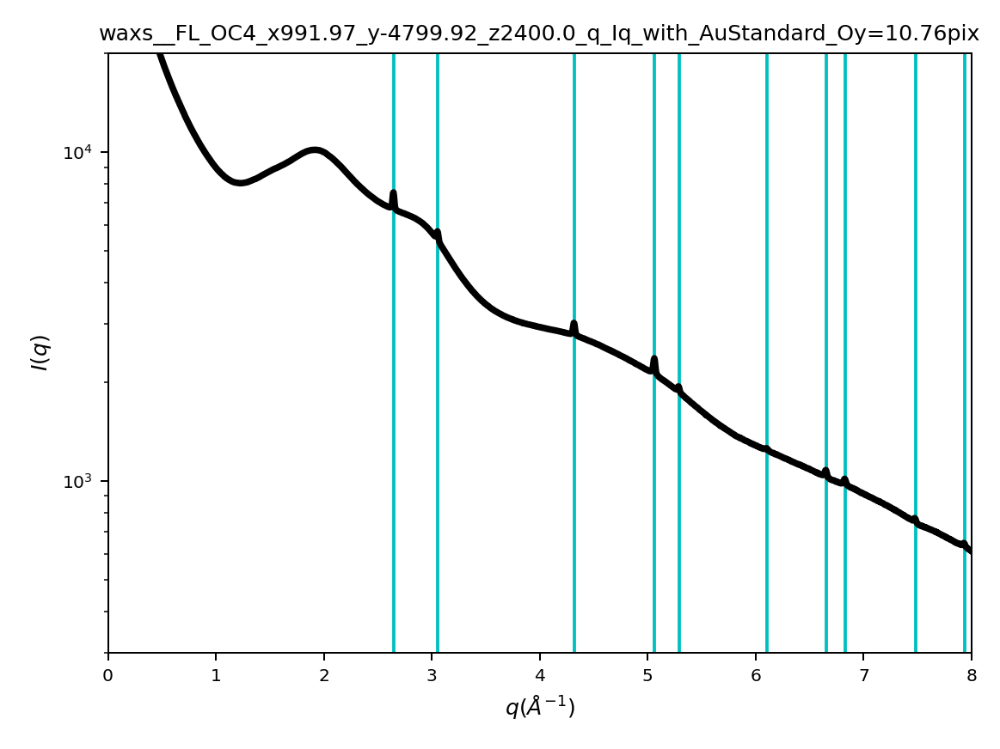

The sample is: 11.
['_FL_OC4_x991.96_y-4799.92_z3400.0_waxsP00.00_expt1s_attNone_sid00136333_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.9_z3400.0_waxsP06.50_expt1s_attNone_sid00136363_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.76_z3399.99_waxsP13.00_expt1s_attNone_sid00136393_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.91_z3400.0_waxsP19.50_expt1s_attNone_sid00136423_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.83_z3400.0_waxsP26.00_expt1s_attNone_sid00136453_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.87_z3400.0_waxsP32.50_expt1s_attNone_sid00136483_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.89_z3400.0_waxsP39.00_expt1s_attNone_sid00136513_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.87_z3400.0_waxsP45.50_expt1s_attNone_sid00136543_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.91_z3400.01_waxsP52.00_expt1s_attNone_sid00136573_000001_WAXS.tif', '_FL_OC4_x991.95_y-4800.19_z3400.0_waxsP58.50_expt1s_attNone_sid00136603_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.84_z3400.0_waxsP65.00_expt1s_attNone_sid00136

<IPython.core.display.Javascript object>


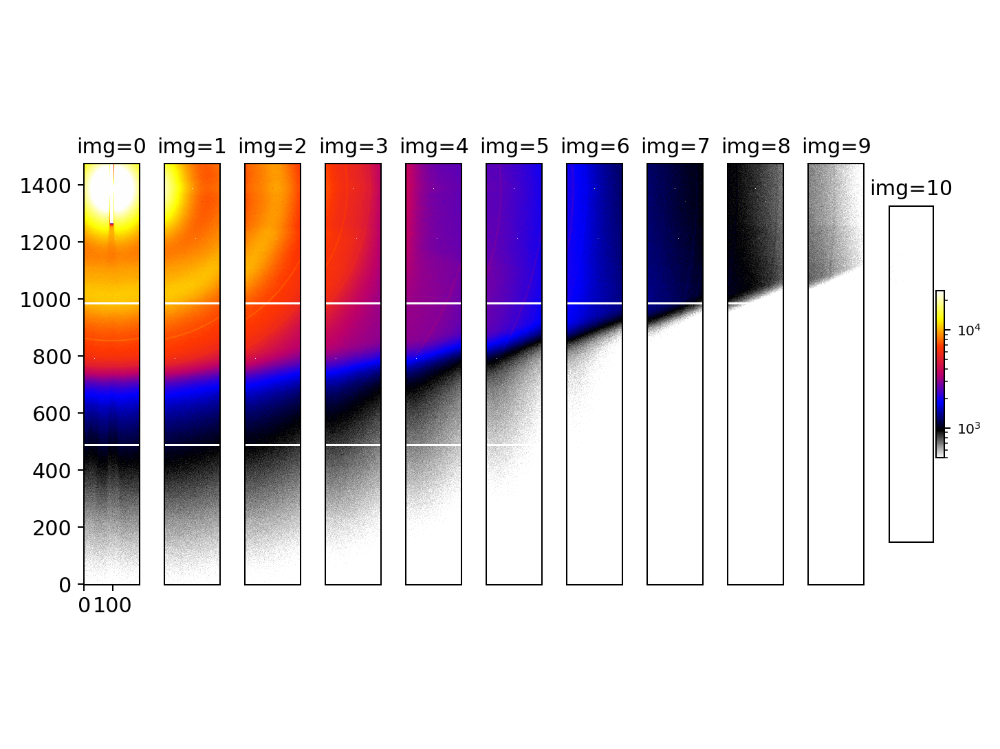

<IPython.core.display.Javascript object>


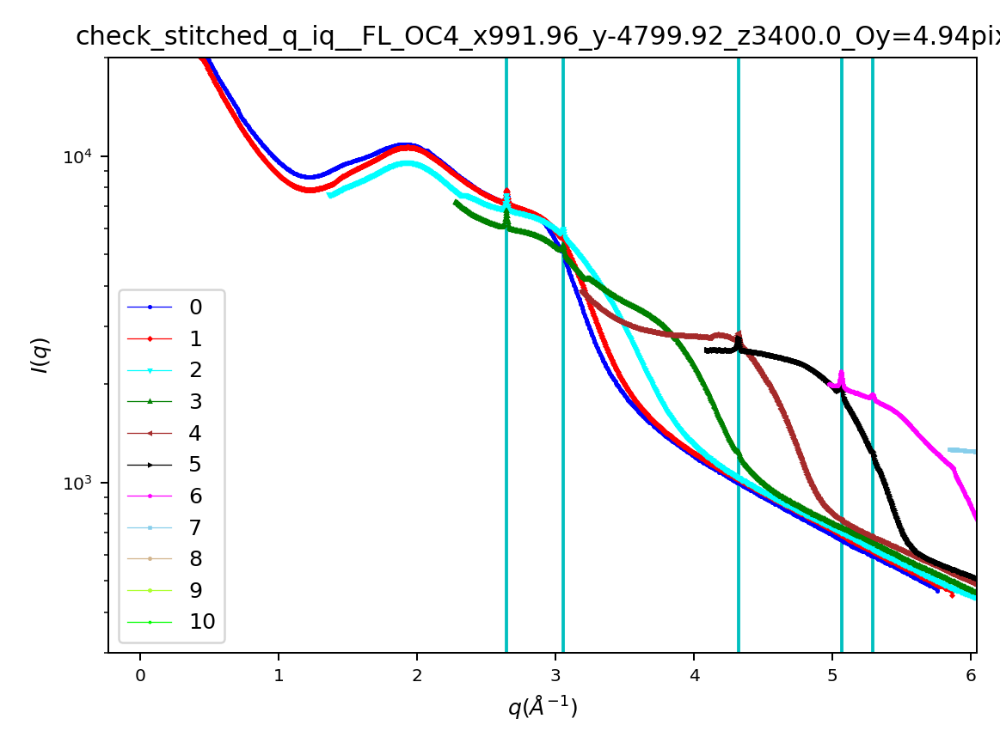

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


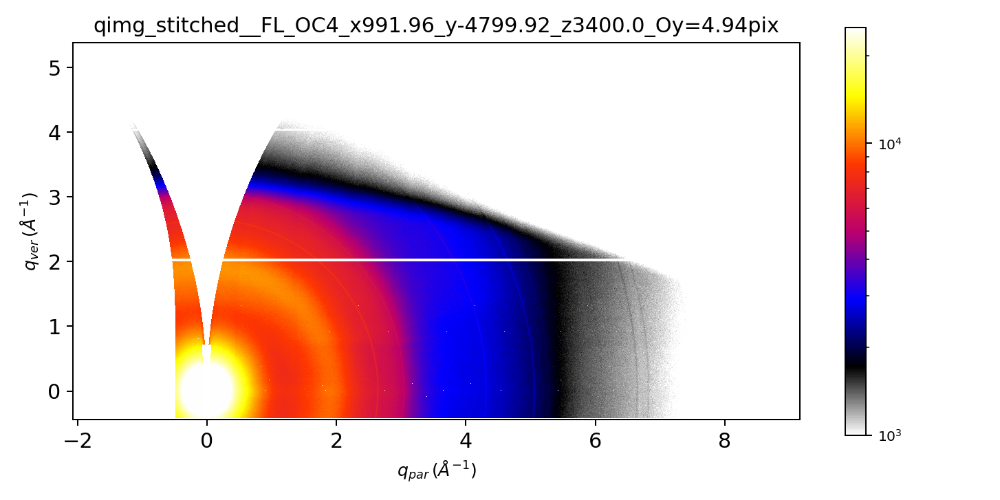

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


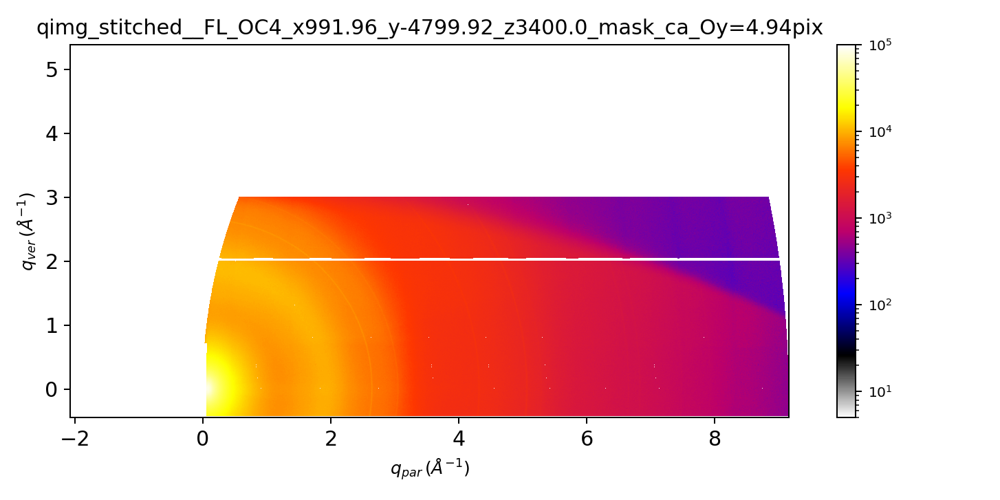

<IPython.core.display.Javascript object>


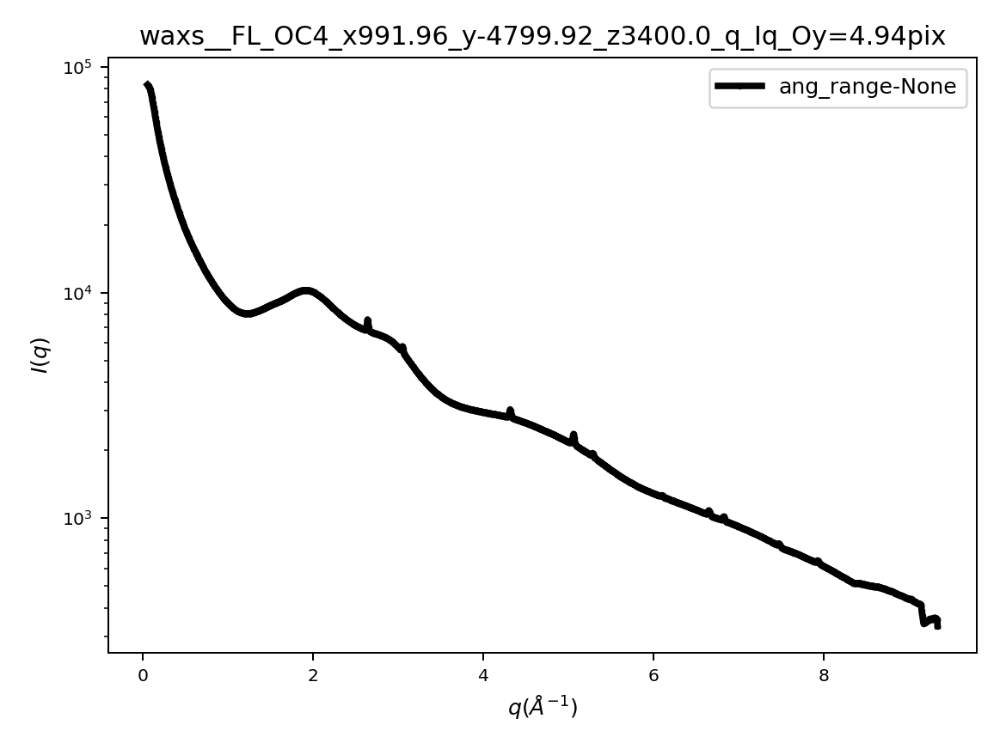

2.6685292985643927


<IPython.core.display.Javascript object>


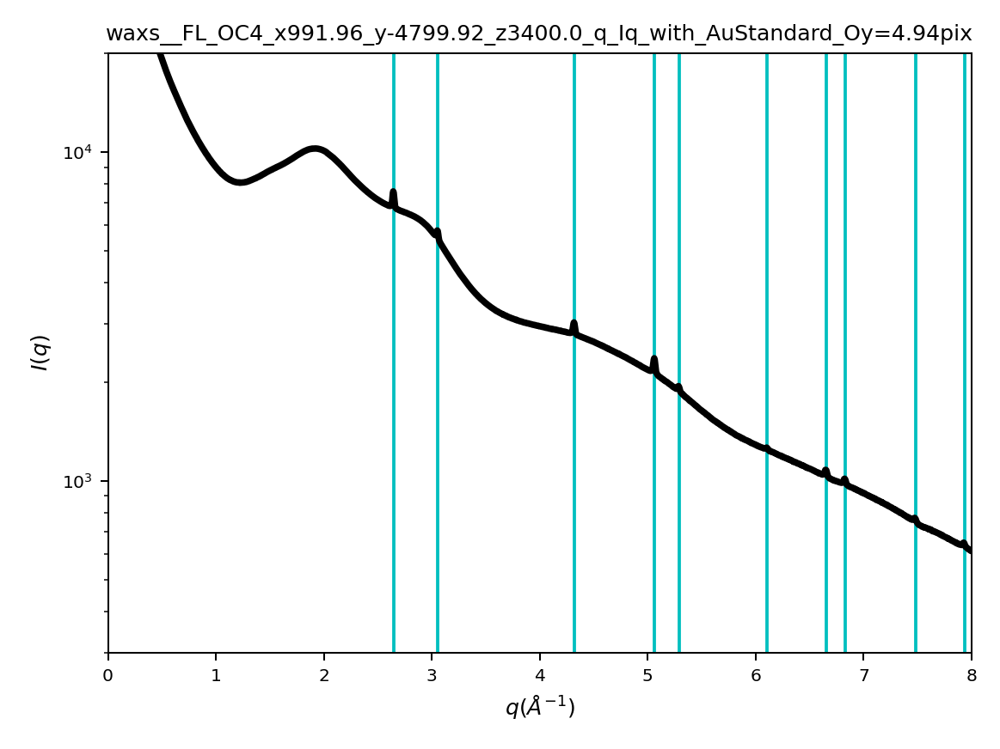

The sample is: 12.
['_FL_OC4_x991.96_y-4799.93_z5400.0_waxsP00.00_expt1s_attNone_sid00136334_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.92_z5400.0_waxsP06.50_expt1s_attNone_sid00136364_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.99_z5400.0_waxsP13.00_expt1s_attNone_sid00136394_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.93_z5399.99_waxsP19.50_expt1s_attNone_sid00136424_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.95_z5400.0_waxsP26.00_expt1s_attNone_sid00136454_000001_WAXS.tif', '_FL_OC4_x991.97_y-4799.93_z5400.0_waxsP32.50_expt1s_attNone_sid00136484_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.93_z5400.0_waxsP39.00_expt1s_attNone_sid00136514_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.93_z5400.0_waxsP45.50_expt1s_attNone_sid00136544_000001_WAXS.tif', '_FL_OC4_x991.95_y-4799.92_z5400.0_waxsP52.00_expt1s_attNone_sid00136574_000001_WAXS.tif', '_FL_OC4_x991.92_y-4799.96_z5400.0_waxsP58.50_expt1s_attNone_sid00136604_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.93_z5399.99_waxsP65.00_expt1s_attNone_sid0013

<IPython.core.display.Javascript object>


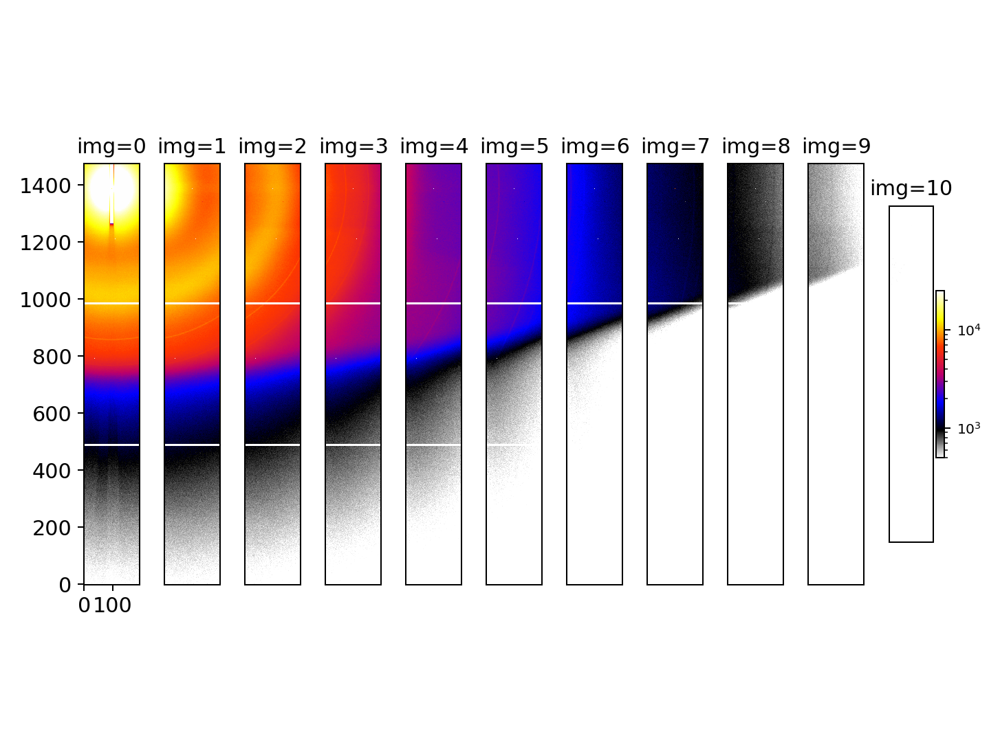

<IPython.core.display.Javascript object>


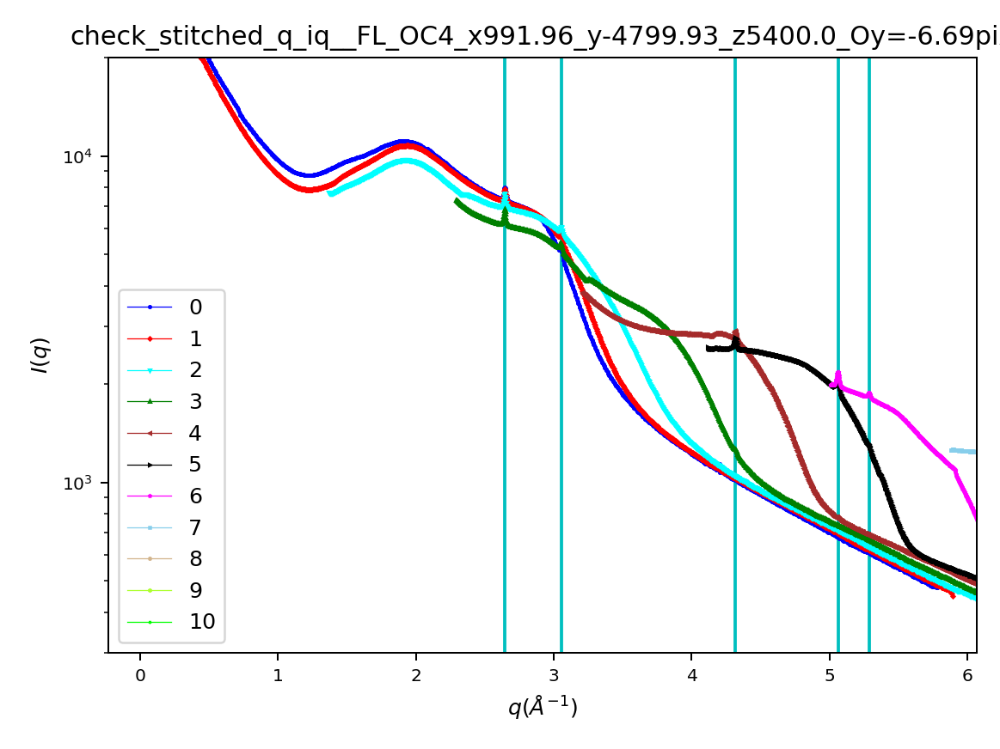

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


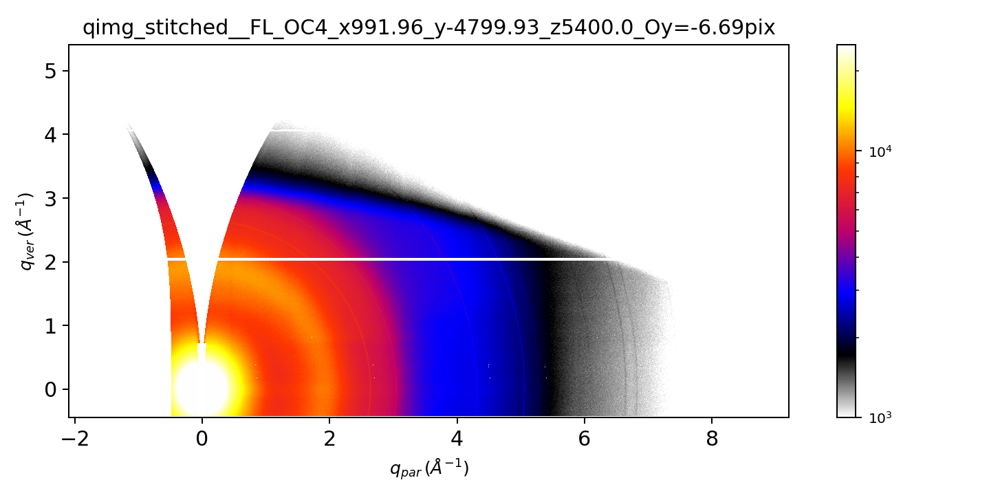

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


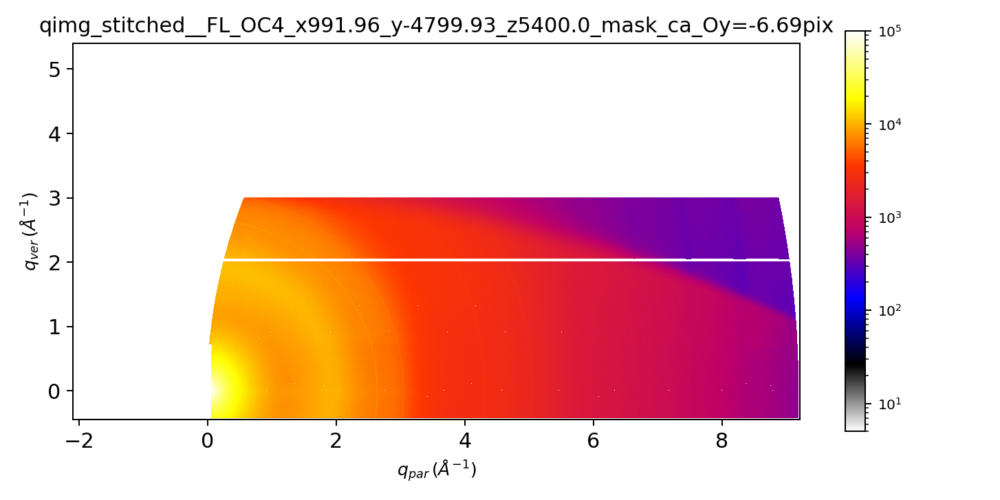

<IPython.core.display.Javascript object>


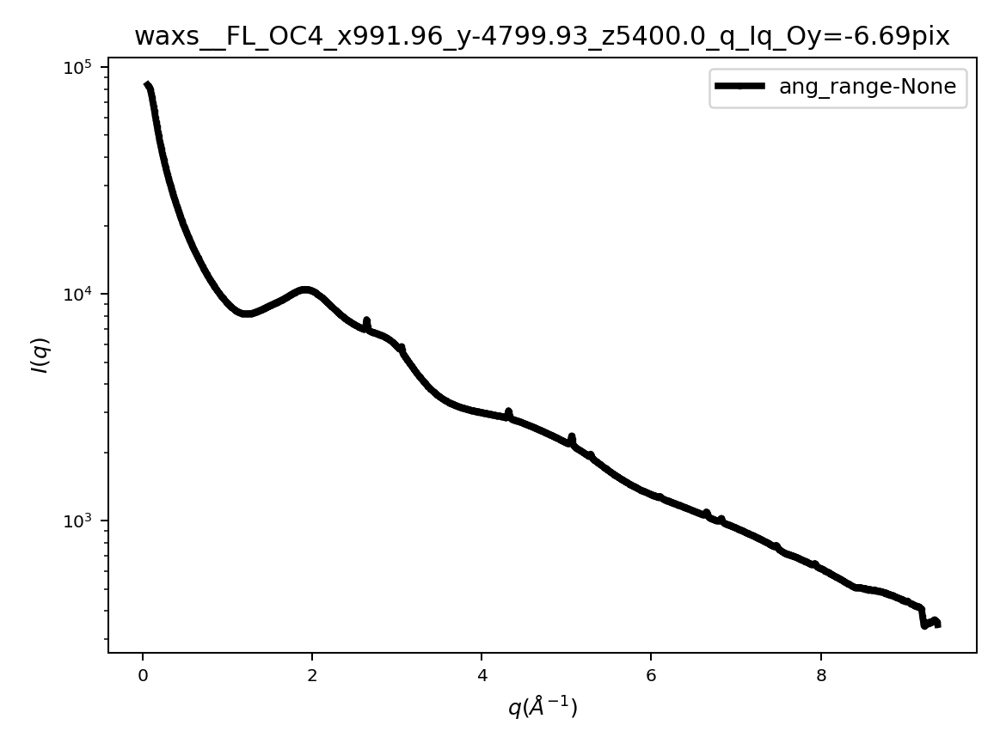

2.6685292985643927


<IPython.core.display.Javascript object>

The sample is: 13.
['_FL_OC4_x991.98_y-4800.07_z9400.0_waxsP00.00_expt1s_attNone_sid00136335_000001_WAXS.tif', '_FL_OC4_x991.98_y-4800.04_z9400.0_waxsP06.50_expt1s_attNone_sid00136365_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.96_z9400.0_waxsP13.00_expt1s_attNone_sid00136395_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.99_z9400.0_waxsP19.50_expt1s_attNone_sid00136425_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.96_z9400.0_waxsP26.00_expt1s_attNone_sid00136455_000001_WAXS.tif', '_FL_OC4_x991.99_y-4799.93_z9400.0_waxsP32.50_expt1s_attNone_sid00136485_000001_WAXS.tif', '_FL_OC4_x991.97_y-4800.03_z9400.0_waxsP39.00_expt1s_attNone_sid00136515_000001_WAXS.tif', '_FL_OC4_x991.98_y-4799.97_z9400.0_waxsP45.50_expt1s_attNone_sid00136545_000001_WAXS.tif', '_FL_OC4_x991.97_y-4800.02_z9400.0_waxsP52.00_expt1s_attNone_sid00136575_000001_WAXS.tif', '_FL_OC4_x991.96_y-4799.98_z9400.0_waxsP58.50_expt1s_attNone_sid00136605_000001_WAXS.tif', '_FL_OC4_x991.94_y-4799.91_z9400.0_waxsP65.00_expt1s_attNone_sid001366

<IPython.core.display.Javascript object>


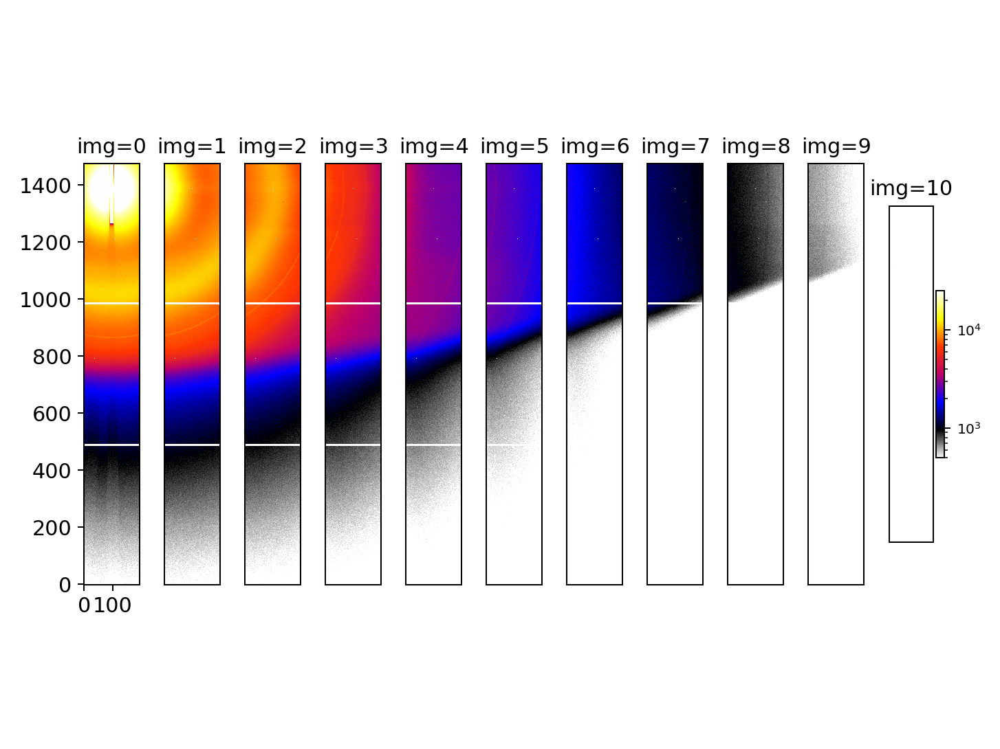

<IPython.core.display.Javascript object>


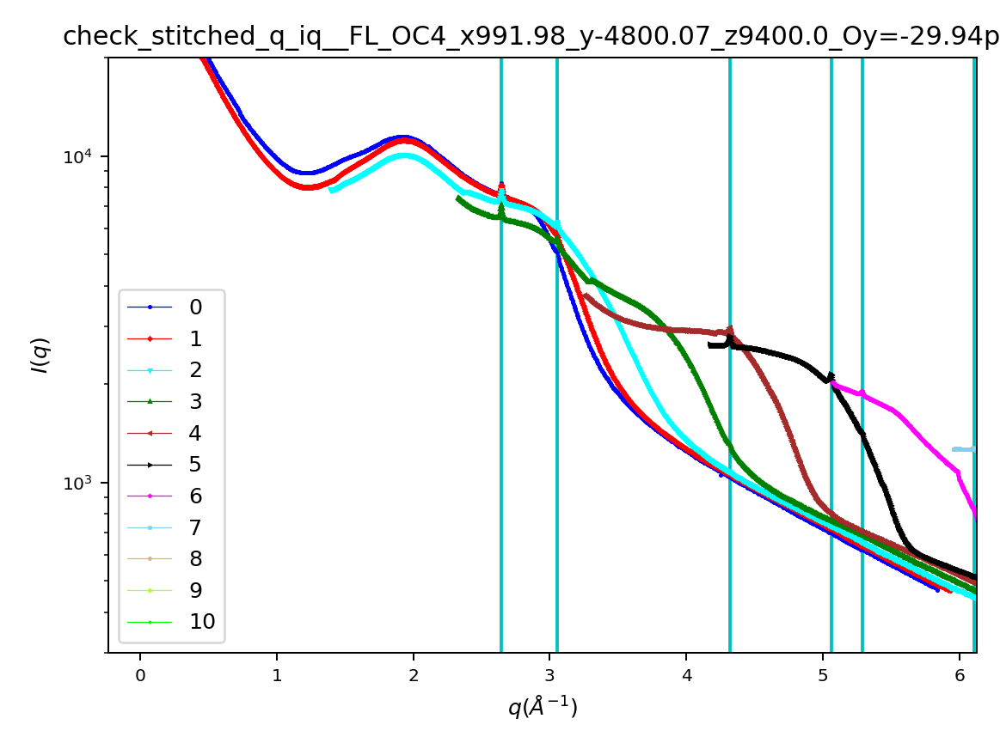

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


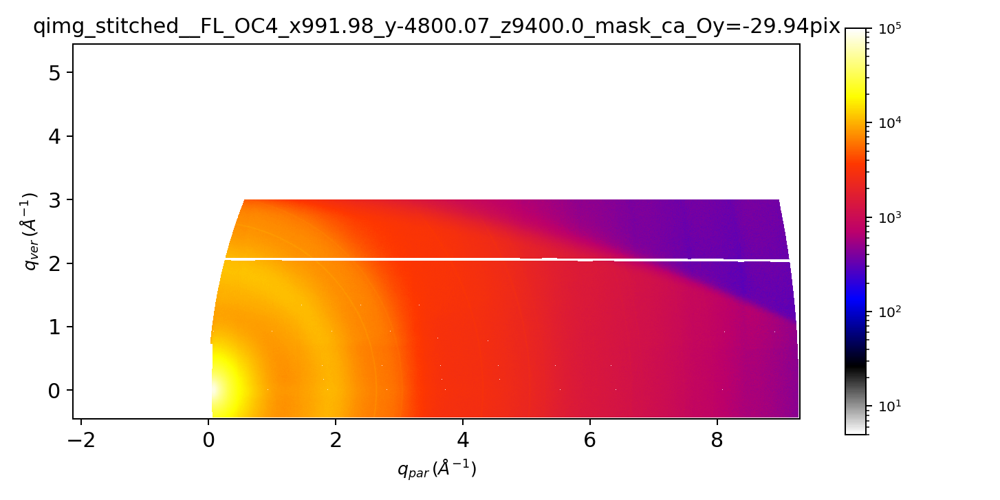

<IPython.core.display.Javascript object>


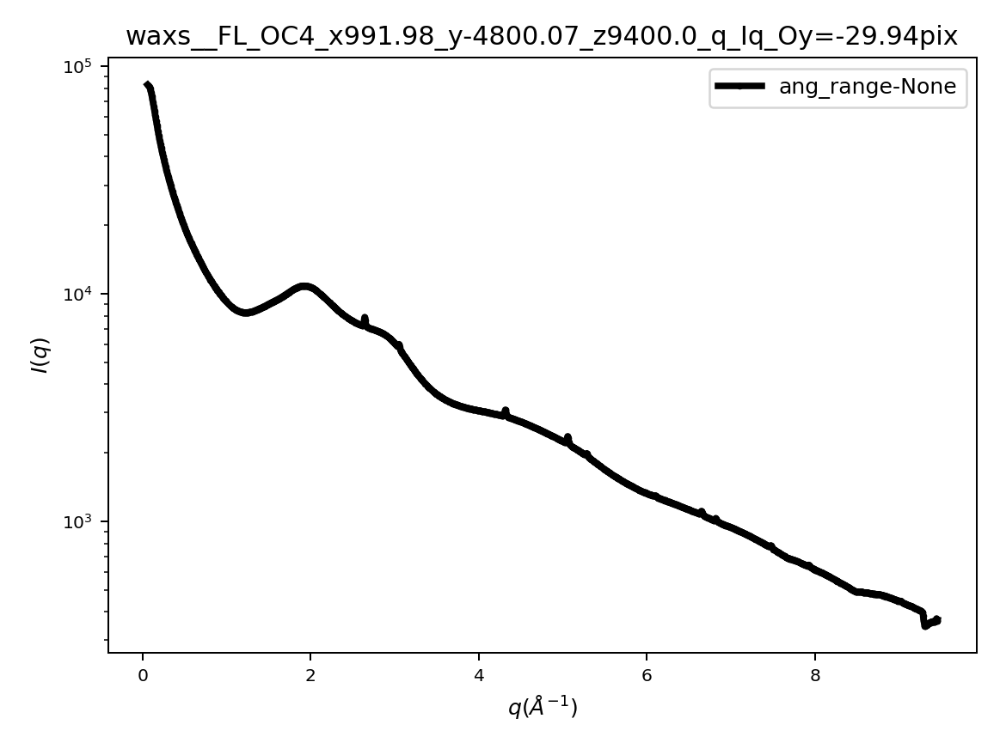

2.6685292985643927


<IPython.core.display.Javascript object>

The sample is: 14.
['_FL_OC4_x992.01_y-4800.28_z17400.0_waxsP00.00_expt1s_attNone_sid00136336_000001_WAXS.tif', '_FL_OC4_x992.01_y-4800.2_z17400.0_waxsP06.50_expt1s_attNone_sid00136366_000001_WAXS.tif', '_FL_OC4_x992.0_y-4800.07_z17400.0_waxsP13.00_expt1s_attNone_sid00136396_000001_WAXS.tif', '_FL_OC4_x991.98_y-4800.19_z17400.0_waxsP19.50_expt1s_attNone_sid00136426_000001_WAXS.tif', '_FL_OC4_x992.0_y-4800.18_z17400.0_waxsP26.00_expt1s_attNone_sid00136456_000001_WAXS.tif', '_FL_OC4_x992.0_y-4800.04_z17400.0_waxsP32.50_expt1s_attNone_sid00136486_000001_WAXS.tif', '_FL_OC4_x992.0_y-4800.07_z17400.0_waxsP39.00_expt1s_attNone_sid00136516_000001_WAXS.tif', '_FL_OC4_x992.02_y-4800.19_z17400.0_waxsP45.50_expt1s_attNone_sid00136546_000001_WAXS.tif', '_FL_OC4_x991.99_y-4800.04_z17400.0_waxsP52.00_expt1s_attNone_sid00136576_000001_WAXS.tif', '_FL_OC4_x992.0_y-4800.18_z17400.0_waxsP58.50_expt1s_attNone_sid00136606_000001_WAXS.tif', '_FL_OC4_x991.97_y-4800.07_z17400.0_waxsP65.00_expt1s_attNone_sid0

<IPython.core.display.Javascript object>


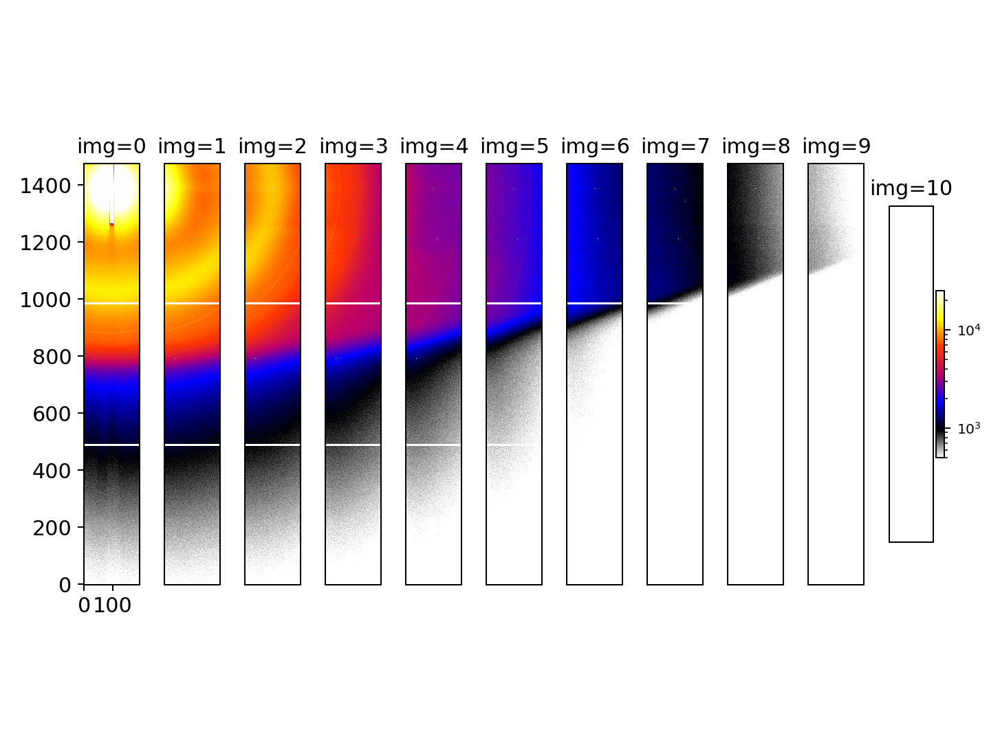

<IPython.core.display.Javascript object>


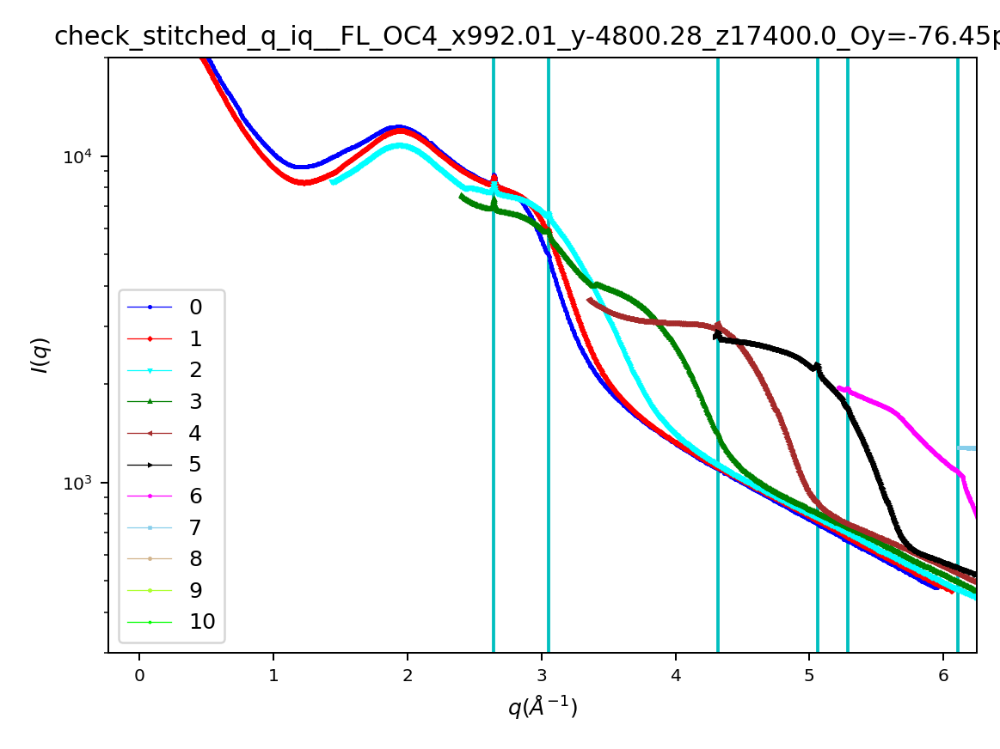

/home/yuzhang/Software/pyScatt/pyScatt/Scattering_Functions.py:816: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


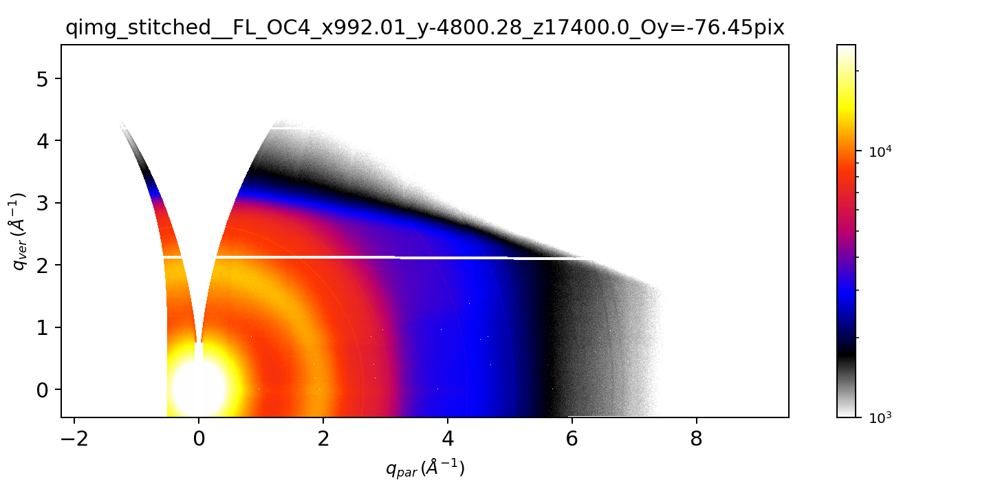

/home/group/Software/pyScatt/pyScatt/plots.py:66: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axes.append( fig.add_subplot(H,V,i+1)    )


<IPython.core.display.Javascript object>


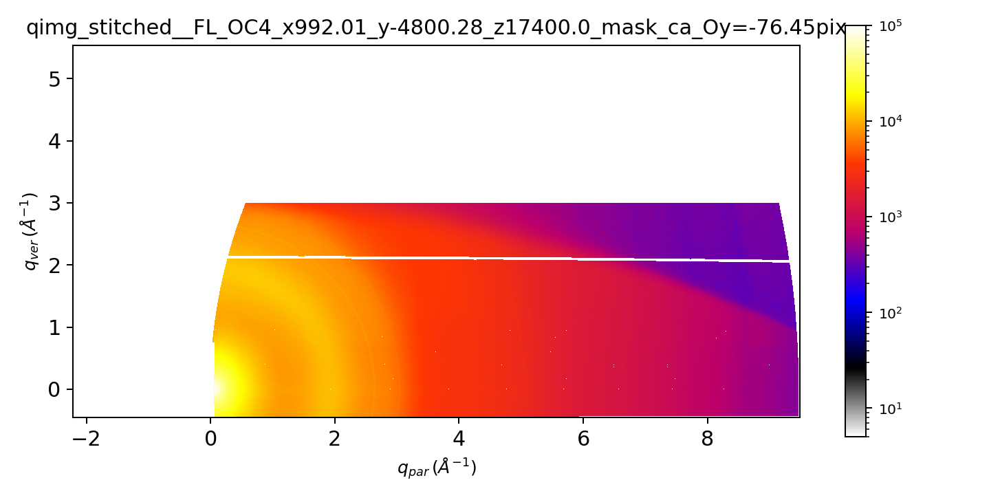

<IPython.core.display.Javascript object>


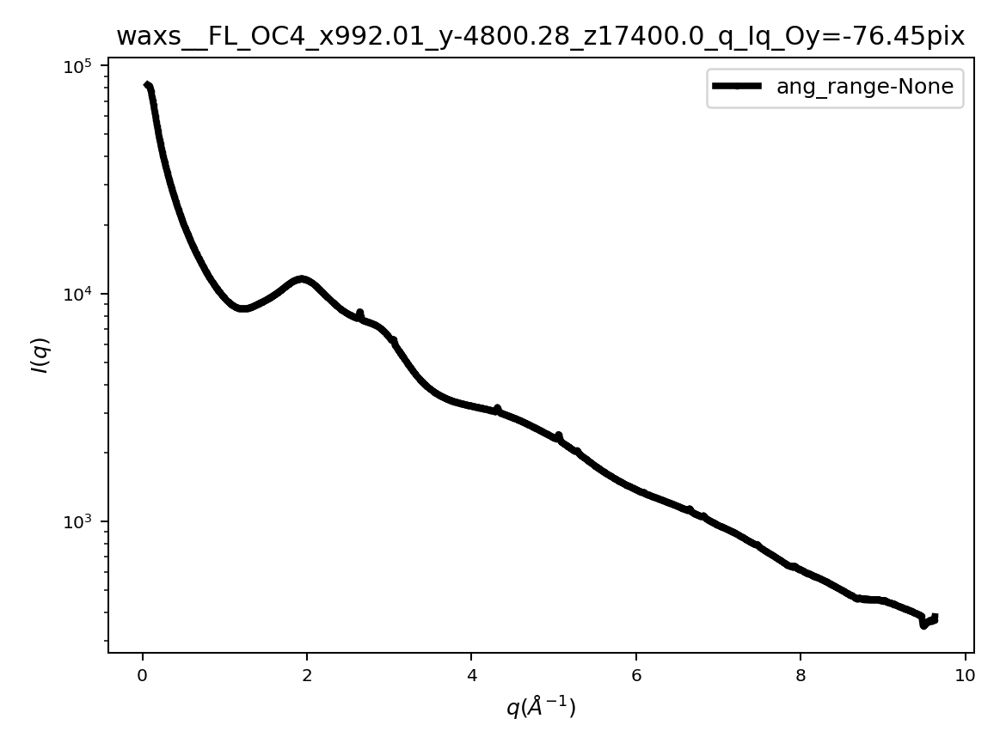

2.6685292985643927


<IPython.core.display.Javascript object>


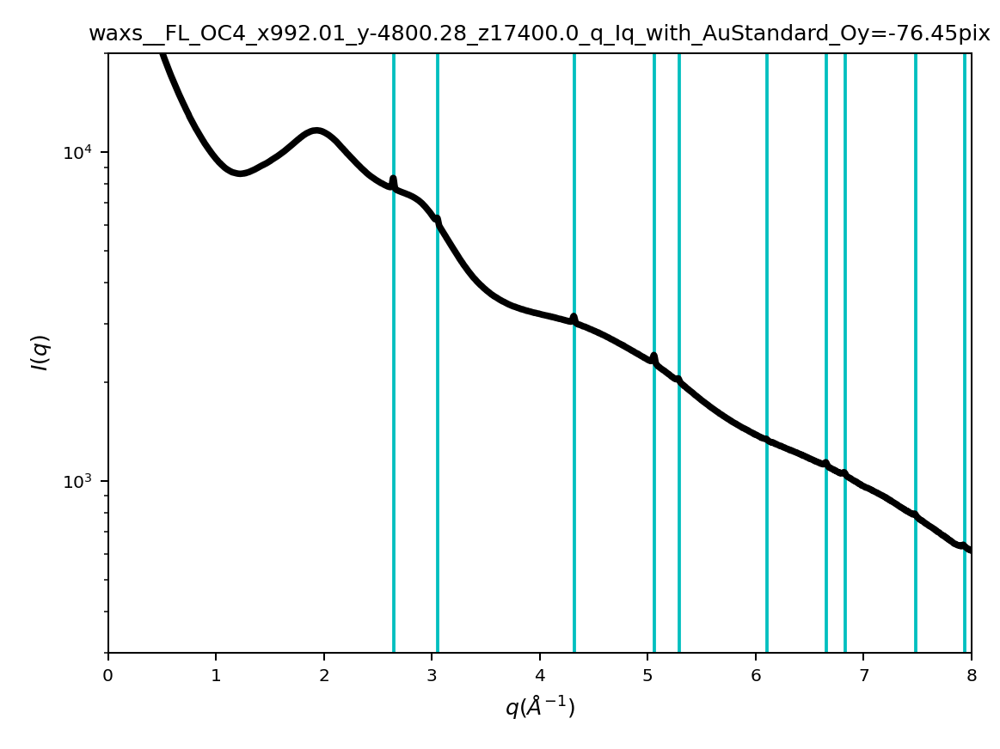

Done


In [266]:
#loop all samples
#for sam in sample_list: 
#kis = [ 0  ]
kis = ks
for ki in kis:
    sam = ks[ki]
    print( 'The sample is: %s.'%sam)    
    fps = ssam_dict[sam][0:]  
    print( fps )
    full_filenames = [ inDir +  fp for fp in fps   ] 
    N =  len(full_filenames)
    rot_angle = -np.arange( rot_angle_start,  rot_angle_step * N,  rot_angle_step )
    print(rot_angle)
    ## Setup the class
    #SC = SMI_Scattering( pargs_sc  )
    #SC.set_rotation_angles( rot_angle  )     
    #SC.set_sdd( sdd_mm + sdd_dz/1000.  )    
    pz = pz_list[ ki ] 
    pargs_sc['sdd_mm'] = sdd_mm  - pz/1000.  
    pargs_sc['rotation_angles'] = rot_angle
    SC = SMI_Scattering( pargs_sc  )    
    sam = fps[0][:-54] 
    SC.md['sample'] = sam
    SC.load_data( full_filenames )  
    #SC.md['sid'] =  []
    #######################################
    #plot the raw data
    ########################################
    if do_plot_raw:
        title='raw_%s'%(sam) 
        SC.plot_imgs( imgs=SC.imgs, title=title, vmin= 5e2, vmax= 2.5e4, save=True,mask= mask, fontsize=6, outDir=SC.outDir + 'pngs/' )
        if not do_show_plot:
            plt.close(fig) 
    offset_y =   - round( ( pz - 4250.0)/172.0,2 ) 
    #offset_y = 40 #4.7 # 10.0  #-31.0 #-77.5 #110 #160 #84    
    if check_stitch:        
        q_ch, iq_ch, int_dict_ch, qx_dict_ch, qz_dict_ch = SC.check_stitich( offset_y = offset_y )  
        if do_plot:
            title =  'check_stitched_q_iq_%s_Oy=%spix'%(sam ,offset_y)  
            fig, ax = plt.subplots()
            SC.plot_check_stitich( title=title,fig_ax=[fig,ax],  ) 
            ax.vlines( 2.645 * p_fcc[:10], 0, 1e5, color='c',)
            ax.set_ylim( 300, 2e4)  
            plt.tight_layout()
            plt.savefig(  SC.outDir + 'pngs/'   + title + '_.png')              
    if do_stitch:
        dq_mag = 5        
        qimg_st, msk_st, qx_st, qz_st, sca_st = SC.stitich( dq_mag = dq_mag, offset_y= offset_y, flag_scale= T ) 
        save_array_to_tiff( qimg_st, SC.outDir + '%s_Oy=%spix_Stitched.tiff'%(sam,offset_y ) )
        save_lists( [qx_st], label=['qx_st' ], filename='%s_Oy=%spix_Stitched_qx.csv'%(sam,offset_y ), path = SC.outDir )
        save_lists( [ qz_st], label=['qz_st' ], filename='%s_Oy=%spix_Stitched_qz.csv'%(sam,offset_y ), path = SC.outDir )
        if do_plot:
            title= 'qimg_stitched_%s_Oy=%spix'%(sam ,offset_y)
            SC.plot_stitched_waxs( title=title,  vmin= 10e2, vmax= 2.5e4, save=True, outDir=SC.outDir + 'pngs/' )  
            
            
    if do_ciravg:   
        Prange =  None
        Qrange =  None
        qx_roi_range = [0, qx_st.max()]
        #qz_roi_range= [qz_st.min(), qz_st.max() ]         #  [qz_st.min(), 1.1 ] 
        qz_roi_range= [qz_st.min(),  3 ]         #  [qz_st.min(), 1.1 ]         
        
        ciravg_bins  = 2500 
        qmaskn = create_roiMask_from_Qimg( qimg=qimg_st, qx_range=qx_st, 
                                  qz_range=qz_st, qx_roi_range=qx_roi_range,qz_roi_range=qz_roi_range,qmask =msk_st )         
        q_ca,iq_ca,mask_ca = SC.qimg_circular_average( qimg_st, qx_st, qz_st, 
                                                      bins=ciravg_bins, Prange= Prange, Qrange= Qrange,
                                                      mask=qmaskn )
        SC.qx_roi_range_ca = qx_roi_range
        SC.qz_roi_range_ca = qz_roi_range        
        if T:#do_plot:
            title= 'qimg_stitched_%s_mask_ca_Oy=%spix'%(sam ,offset_y)
            SC.plot_stitched_waxs(  img=SC.qimg_st * qmaskn, vmin= 5.00, vmax=1e5,title= title, save=True, outDir=SC.outDir + 'pngs/' )  
            title= 'waxs_%s_q_Iq_Oy=%spix'%(sam ,offset_y)
            fig, ax = plt.subplots()
            SC.plot_q_iq( q_ca,iq_ca, legend = 'ang_range-%s'%Prange,fig_ax=[fig,ax], title = title)  
            #ax.vlines( 2.645 * p_fcc[:10], 0, 1e5, color='c',)
            #ax.set_ylim( 300, 2e4)  
            plt.tight_layout()
            plt.savefig(  SC.outDir + 'pngs/'   + title + '_.png')               
                
    if show_Au_Diff:
        q_Au = 2*np.sqrt(3)*np.pi/4.0782
        print( q_Au )
        title =  'waxs_%s_q_Iq_with_AuStandard_Oy=%spix'%(sam ,offset_y)
        fig, ax = plt.subplots()
        SC.plot_q_iq(  SC.q_ca,  SC.iq_ca, m='o', c='k', logy=True, fig_ax=[fig,ax],
                     title=title, markersize=.1, xlim=[0,8], fontsize= 10 )
        ax.vlines( 2.645 * p_fcc[:10], 0, 1e5, color='c',)
        ax.set_ylim( 300, 2e4)  
        plt.tight_layout()
        plt.savefig(  SC.outDir + 'pngs/'   + title + '_.png')   
    

    ## save data to h5 file 
    res = SC.res_to_dict( do_stitch=do_stitch, do_ciravg =do_ciravg, save_raw=save_raw,)#do_qphi = do_qphi, 
                          #do_q_qphi = do_q_qphi, do_p_qphi = do_p_qphi, )
    res['md'] = {} 
    res['md'].update( SC.md   )
    res['md']['pz'] = pz
    res['md']['offestY'] =  offset_y
    res['md']['offestY_formula'] =  "-round( ( pz - 4250.0)/172.0,2 ) "
    res['md']['sdd_formula'] = " 273.9 + 1.4 - pz/1000. "
    
    dicttoh5( res, os.path.join(outDir_HDF, '%s.h5'%sam),
                     h5path='/WAXS/', mode='a', overwrite_data=True)           
 
print('Done')    



    
    

# The END!

In [22]:
if F:
    q_Au = 2*np.sqrt(3)*np.pi/4.0782
    print( q_Au )
    fig, ax = plt.subplots()
    plot1D( x=SC.q_ca, y=SC.iq_ca, m='o', c='k', logy=True, ax=ax, markersize=.1, xlim=[2,8] )
    ax.vlines( 2.645 * p_fcc[:10], .5e3, 5e4, color='c',)
    ax.set_ylim( 300, 1e4)
    

In [23]:
if F:
    fig, ax = plt.subplots()
    qimgc = qimg.copy()
    rc = 630
    ring_mask = create_ring_mask( qimg.shape, r1=rc-10, r2=rc+10, center = [450, 186 ]  )
    qimgc[ring_mask] *=1e3


    SC.plot_img( img=qimgc, title='qimg_%s'%(sami), fontsize=6 , fig_ax = [fig,ax])
    #SC.plot_qrz( img=qimg, x=qx, y=qz, title='qimg_%s'%(sami), fontsize=6 , fig_ax = [fig,ax])

